# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: data: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

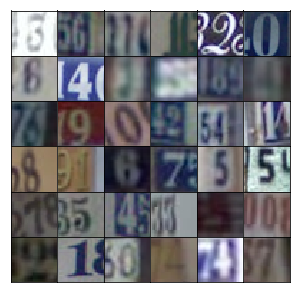

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stck
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha*x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha*x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha*x3, x3)
        # 16x16x128 now
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha*x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha*bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha*bn3, bn3)
        # 4x4x256
        
        # Flatten it 
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [21]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.001
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.0726... Generator Loss: 16.1296
Epoch 1/25... Discriminator Loss: 0.1333... Generator Loss: 13.9154
Epoch 1/25... Discriminator Loss: 0.1351... Generator Loss: 12.8279
Epoch 1/25... Discriminator Loss: 1.2553... Generator Loss: 3.9195
Epoch 1/25... Discriminator Loss: 0.7883... Generator Loss: 2.0891
Epoch 1/25... Discriminator Loss: 0.7308... Generator Loss: 1.0585
Epoch 1/25... Discriminator Loss: 0.9733... Generator Loss: 1.3035
Epoch 1/25... Discriminator Loss: 0.5877... Generator Loss: 1.2789
Epoch 1/25... Discriminator Loss: 1.2552... Generator Loss: 0.9587
Epoch 1/25... Discriminator Loss: 2.8919... Generator Loss: 5.2398


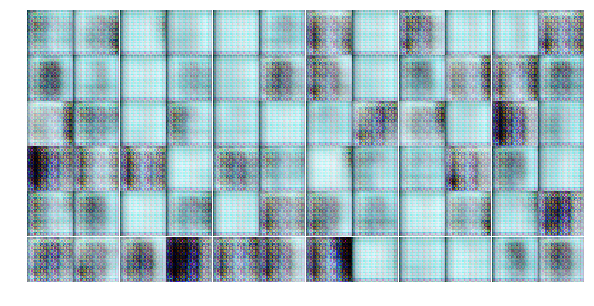

Epoch 1/25... Discriminator Loss: 1.0773... Generator Loss: 1.0769
Epoch 1/25... Discriminator Loss: 1.4198... Generator Loss: 0.4347
Epoch 1/25... Discriminator Loss: 2.1422... Generator Loss: 0.2974
Epoch 1/25... Discriminator Loss: 0.4556... Generator Loss: 1.8329
Epoch 1/25... Discriminator Loss: 1.2529... Generator Loss: 2.1540
Epoch 1/25... Discriminator Loss: 1.0986... Generator Loss: 0.8081
Epoch 1/25... Discriminator Loss: 0.6807... Generator Loss: 1.2227
Epoch 1/25... Discriminator Loss: 0.8194... Generator Loss: 1.6020
Epoch 1/25... Discriminator Loss: 2.0458... Generator Loss: 3.2367
Epoch 1/25... Discriminator Loss: 0.4957... Generator Loss: 1.4038


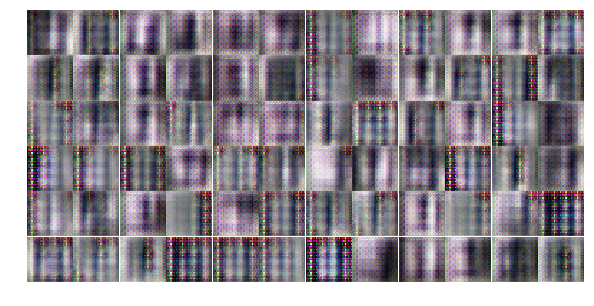

Epoch 1/25... Discriminator Loss: 3.2005... Generator Loss: 0.3340
Epoch 1/25... Discriminator Loss: 1.0912... Generator Loss: 0.9527
Epoch 1/25... Discriminator Loss: 0.8019... Generator Loss: 1.0939
Epoch 1/25... Discriminator Loss: 1.0223... Generator Loss: 0.8562
Epoch 1/25... Discriminator Loss: 1.1613... Generator Loss: 0.7327
Epoch 1/25... Discriminator Loss: 1.0899... Generator Loss: 1.2172
Epoch 1/25... Discriminator Loss: 1.0927... Generator Loss: 0.6758
Epoch 1/25... Discriminator Loss: 1.4583... Generator Loss: 0.4389
Epoch 1/25... Discriminator Loss: 1.3897... Generator Loss: 0.7604
Epoch 1/25... Discriminator Loss: 1.4117... Generator Loss: 2.4103


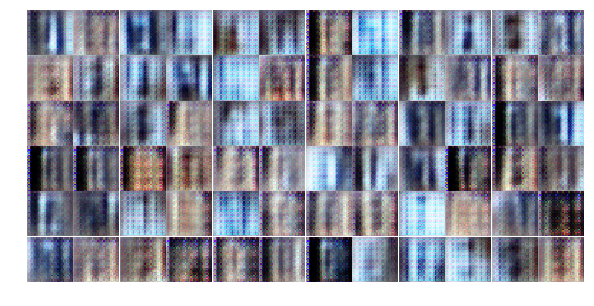

Epoch 1/25... Discriminator Loss: 1.0641... Generator Loss: 1.0324
Epoch 1/25... Discriminator Loss: 1.1964... Generator Loss: 0.8022
Epoch 1/25... Discriminator Loss: 0.5766... Generator Loss: 2.4323
Epoch 1/25... Discriminator Loss: 0.9517... Generator Loss: 1.0810
Epoch 1/25... Discriminator Loss: 1.0925... Generator Loss: 0.7146
Epoch 1/25... Discriminator Loss: 0.9879... Generator Loss: 3.4616
Epoch 1/25... Discriminator Loss: 0.8346... Generator Loss: 1.3494
Epoch 1/25... Discriminator Loss: 0.8135... Generator Loss: 1.2912
Epoch 1/25... Discriminator Loss: 1.2906... Generator Loss: 0.5442
Epoch 1/25... Discriminator Loss: 2.4149... Generator Loss: 3.0162


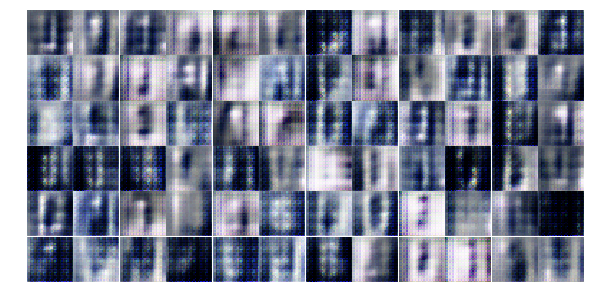

Epoch 1/25... Discriminator Loss: 0.8673... Generator Loss: 0.9847
Epoch 1/25... Discriminator Loss: 1.1918... Generator Loss: 1.0397
Epoch 1/25... Discriminator Loss: 1.4715... Generator Loss: 0.5330
Epoch 1/25... Discriminator Loss: 0.8861... Generator Loss: 1.0075
Epoch 1/25... Discriminator Loss: 1.0685... Generator Loss: 0.8753
Epoch 1/25... Discriminator Loss: 2.6764... Generator Loss: 2.4925
Epoch 1/25... Discriminator Loss: 1.1714... Generator Loss: 0.8174
Epoch 1/25... Discriminator Loss: 1.1663... Generator Loss: 0.8202
Epoch 1/25... Discriminator Loss: 0.9244... Generator Loss: 1.5631
Epoch 1/25... Discriminator Loss: 0.9451... Generator Loss: 1.0067


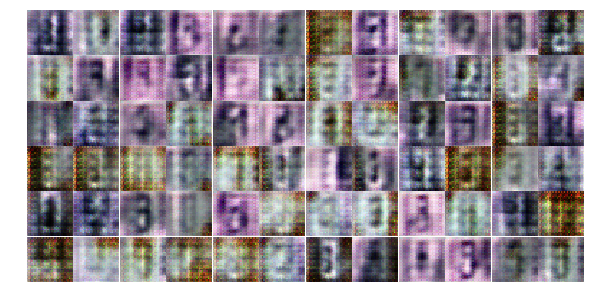

Epoch 1/25... Discriminator Loss: 1.2732... Generator Loss: 0.8710
Epoch 1/25... Discriminator Loss: 1.0867... Generator Loss: 1.0429
Epoch 1/25... Discriminator Loss: 1.0978... Generator Loss: 1.6574
Epoch 1/25... Discriminator Loss: 1.3725... Generator Loss: 0.7134
Epoch 1/25... Discriminator Loss: 1.6208... Generator Loss: 0.5229
Epoch 1/25... Discriminator Loss: 1.2941... Generator Loss: 0.9158
Epoch 1/25... Discriminator Loss: 1.3935... Generator Loss: 0.6698
Epoch 2/25... Discriminator Loss: 0.9388... Generator Loss: 1.3415
Epoch 2/25... Discriminator Loss: 1.1222... Generator Loss: 1.3012
Epoch 2/25... Discriminator Loss: 1.0381... Generator Loss: 0.7856


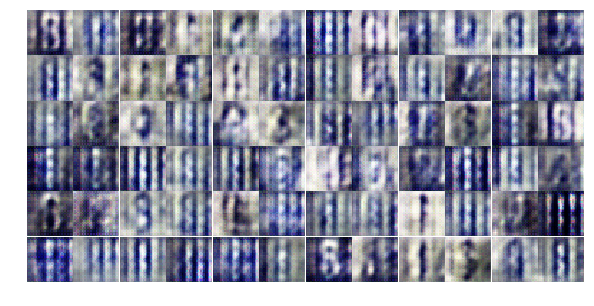

Epoch 2/25... Discriminator Loss: 1.5417... Generator Loss: 0.4239
Epoch 2/25... Discriminator Loss: 1.1466... Generator Loss: 1.0413
Epoch 2/25... Discriminator Loss: 1.3520... Generator Loss: 0.6200
Epoch 2/25... Discriminator Loss: 1.2514... Generator Loss: 0.8542
Epoch 2/25... Discriminator Loss: 1.2834... Generator Loss: 0.7572
Epoch 2/25... Discriminator Loss: 1.3528... Generator Loss: 0.9989
Epoch 2/25... Discriminator Loss: 1.1497... Generator Loss: 0.7262
Epoch 2/25... Discriminator Loss: 1.7360... Generator Loss: 0.5223
Epoch 2/25... Discriminator Loss: 2.3852... Generator Loss: 0.1657
Epoch 2/25... Discriminator Loss: 1.3802... Generator Loss: 0.8555


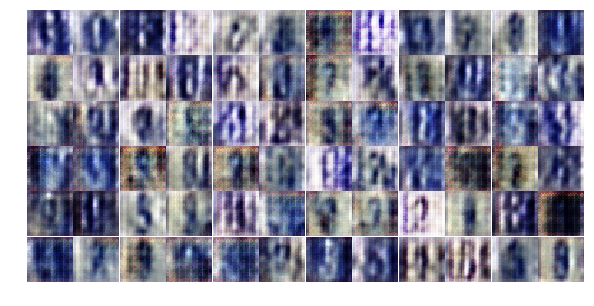

Epoch 2/25... Discriminator Loss: 1.3160... Generator Loss: 0.6588
Epoch 2/25... Discriminator Loss: 0.9579... Generator Loss: 0.9706
Epoch 2/25... Discriminator Loss: 1.1100... Generator Loss: 1.0274
Epoch 2/25... Discriminator Loss: 1.2987... Generator Loss: 0.6734
Epoch 2/25... Discriminator Loss: 1.0389... Generator Loss: 1.3118
Epoch 2/25... Discriminator Loss: 1.6580... Generator Loss: 0.7658
Epoch 2/25... Discriminator Loss: 1.4759... Generator Loss: 0.6355
Epoch 2/25... Discriminator Loss: 1.1821... Generator Loss: 0.7377
Epoch 2/25... Discriminator Loss: 1.3021... Generator Loss: 0.8186
Epoch 2/25... Discriminator Loss: 0.9135... Generator Loss: 1.0040


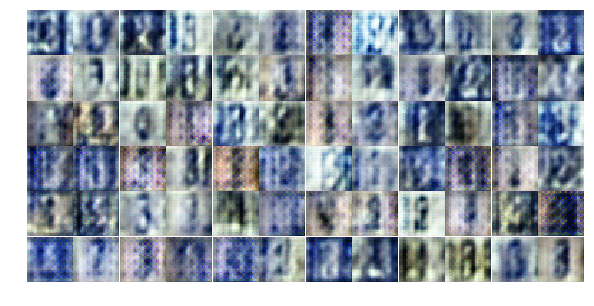

Epoch 2/25... Discriminator Loss: 1.0959... Generator Loss: 1.0493
Epoch 2/25... Discriminator Loss: 1.3277... Generator Loss: 0.7581
Epoch 2/25... Discriminator Loss: 1.1057... Generator Loss: 1.2495
Epoch 2/25... Discriminator Loss: 1.1313... Generator Loss: 0.9154
Epoch 2/25... Discriminator Loss: 1.3929... Generator Loss: 0.8936
Epoch 2/25... Discriminator Loss: 1.1742... Generator Loss: 1.2353
Epoch 2/25... Discriminator Loss: 1.0652... Generator Loss: 1.5129
Epoch 2/25... Discriminator Loss: 1.7328... Generator Loss: 0.2848
Epoch 2/25... Discriminator Loss: 1.5507... Generator Loss: 0.4683
Epoch 2/25... Discriminator Loss: 1.6171... Generator Loss: 0.6386


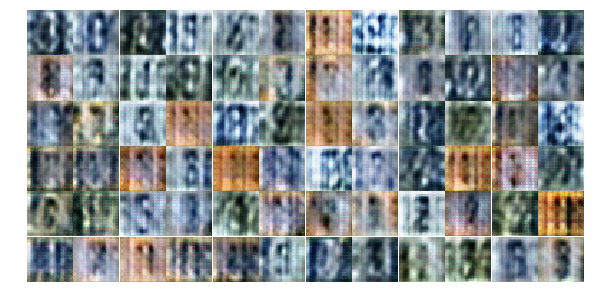

Epoch 2/25... Discriminator Loss: 1.6222... Generator Loss: 0.5839
Epoch 2/25... Discriminator Loss: 1.3929... Generator Loss: 0.7695
Epoch 2/25... Discriminator Loss: 1.1128... Generator Loss: 0.7406
Epoch 2/25... Discriminator Loss: 1.4977... Generator Loss: 0.7067
Epoch 2/25... Discriminator Loss: 1.3526... Generator Loss: 0.6829
Epoch 2/25... Discriminator Loss: 1.4409... Generator Loss: 0.8203
Epoch 2/25... Discriminator Loss: 1.3226... Generator Loss: 0.7586
Epoch 2/25... Discriminator Loss: 1.3624... Generator Loss: 0.7071
Epoch 2/25... Discriminator Loss: 1.3718... Generator Loss: 0.7894
Epoch 2/25... Discriminator Loss: 1.5045... Generator Loss: 0.6687


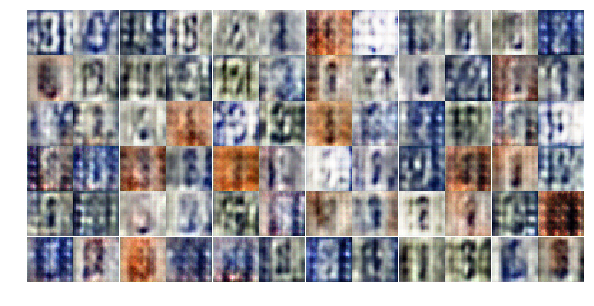

Epoch 2/25... Discriminator Loss: 1.3426... Generator Loss: 0.7452
Epoch 2/25... Discriminator Loss: 1.2205... Generator Loss: 0.9383
Epoch 2/25... Discriminator Loss: 1.2346... Generator Loss: 0.7631
Epoch 2/25... Discriminator Loss: 1.2863... Generator Loss: 0.8804
Epoch 2/25... Discriminator Loss: 1.4721... Generator Loss: 0.7902
Epoch 2/25... Discriminator Loss: 1.4700... Generator Loss: 0.6495
Epoch 2/25... Discriminator Loss: 1.2743... Generator Loss: 0.7928
Epoch 2/25... Discriminator Loss: 1.3360... Generator Loss: 0.8574
Epoch 2/25... Discriminator Loss: 1.3362... Generator Loss: 0.7681
Epoch 2/25... Discriminator Loss: 1.3851... Generator Loss: 0.7708


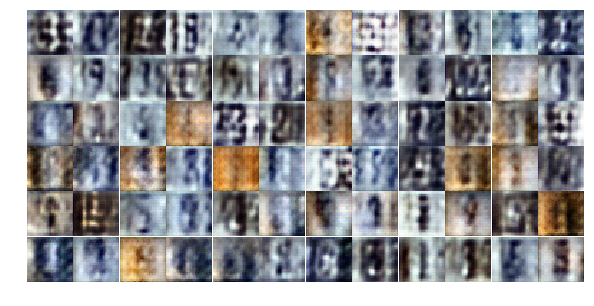

Epoch 2/25... Discriminator Loss: 1.3415... Generator Loss: 0.8601
Epoch 2/25... Discriminator Loss: 1.3174... Generator Loss: 0.8732
Epoch 2/25... Discriminator Loss: 1.1961... Generator Loss: 0.9184
Epoch 2/25... Discriminator Loss: 1.3187... Generator Loss: 1.1677
Epoch 3/25... Discriminator Loss: 1.1308... Generator Loss: 1.0136
Epoch 3/25... Discriminator Loss: 1.1316... Generator Loss: 0.8409
Epoch 3/25... Discriminator Loss: 1.2024... Generator Loss: 0.8167
Epoch 3/25... Discriminator Loss: 1.4791... Generator Loss: 0.6321
Epoch 3/25... Discriminator Loss: 1.3122... Generator Loss: 0.5517
Epoch 3/25... Discriminator Loss: 1.3465... Generator Loss: 0.5861


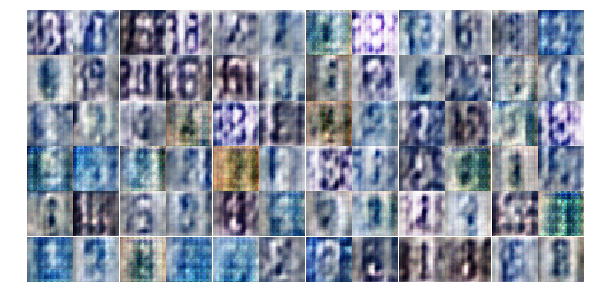

Epoch 3/25... Discriminator Loss: 1.2319... Generator Loss: 0.8096
Epoch 3/25... Discriminator Loss: 1.5376... Generator Loss: 0.5837
Epoch 3/25... Discriminator Loss: 1.5501... Generator Loss: 0.6308
Epoch 3/25... Discriminator Loss: 1.1736... Generator Loss: 0.8847
Epoch 3/25... Discriminator Loss: 1.1426... Generator Loss: 0.9112
Epoch 3/25... Discriminator Loss: 1.3278... Generator Loss: 0.6808
Epoch 3/25... Discriminator Loss: 1.2991... Generator Loss: 0.7563
Epoch 3/25... Discriminator Loss: 1.1532... Generator Loss: 0.8174
Epoch 3/25... Discriminator Loss: 1.2942... Generator Loss: 0.7302
Epoch 3/25... Discriminator Loss: 1.3874... Generator Loss: 0.6182


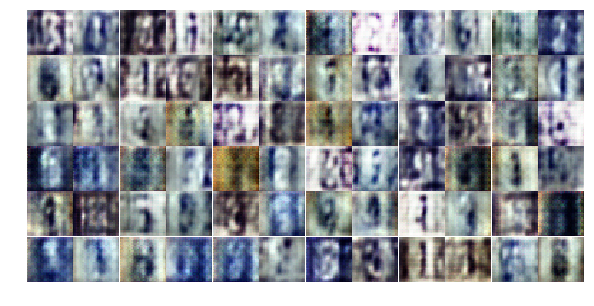

Epoch 3/25... Discriminator Loss: 1.2275... Generator Loss: 0.8206
Epoch 3/25... Discriminator Loss: 1.4142... Generator Loss: 1.0578
Epoch 3/25... Discriminator Loss: 1.3032... Generator Loss: 0.7180
Epoch 3/25... Discriminator Loss: 1.2820... Generator Loss: 0.9792
Epoch 3/25... Discriminator Loss: 1.2251... Generator Loss: 0.8345
Epoch 3/25... Discriminator Loss: 1.2469... Generator Loss: 0.8857
Epoch 3/25... Discriminator Loss: 1.4746... Generator Loss: 0.5787
Epoch 3/25... Discriminator Loss: 1.2714... Generator Loss: 0.7243
Epoch 3/25... Discriminator Loss: 1.1024... Generator Loss: 0.7990
Epoch 3/25... Discriminator Loss: 1.2505... Generator Loss: 0.8469


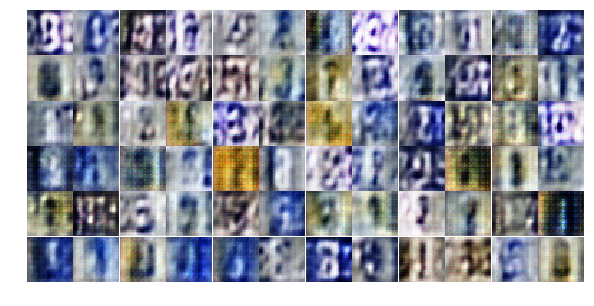

Epoch 3/25... Discriminator Loss: 1.3202... Generator Loss: 0.7590
Epoch 3/25... Discriminator Loss: 1.1922... Generator Loss: 0.7921
Epoch 3/25... Discriminator Loss: 1.2094... Generator Loss: 0.7845
Epoch 3/25... Discriminator Loss: 1.1415... Generator Loss: 0.8264
Epoch 3/25... Discriminator Loss: 1.2423... Generator Loss: 0.8851
Epoch 3/25... Discriminator Loss: 1.1964... Generator Loss: 0.7089
Epoch 3/25... Discriminator Loss: 1.1818... Generator Loss: 0.7530
Epoch 3/25... Discriminator Loss: 1.1894... Generator Loss: 0.8512
Epoch 3/25... Discriminator Loss: 1.3275... Generator Loss: 1.1773
Epoch 3/25... Discriminator Loss: 1.4146... Generator Loss: 1.5262


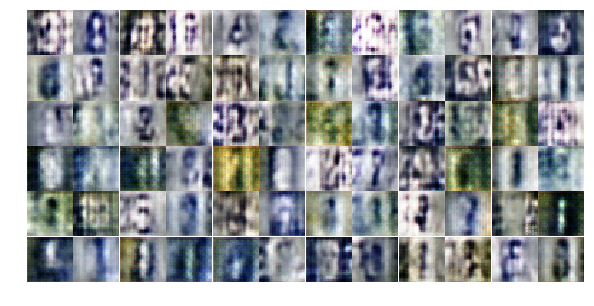

Epoch 3/25... Discriminator Loss: 1.2957... Generator Loss: 0.7773
Epoch 3/25... Discriminator Loss: 1.3676... Generator Loss: 0.9043
Epoch 3/25... Discriminator Loss: 1.4674... Generator Loss: 0.6755
Epoch 3/25... Discriminator Loss: 1.2068... Generator Loss: 0.8275
Epoch 3/25... Discriminator Loss: 1.1119... Generator Loss: 0.9521
Epoch 3/25... Discriminator Loss: 1.2305... Generator Loss: 0.7141
Epoch 3/25... Discriminator Loss: 1.1594... Generator Loss: 1.1656
Epoch 3/25... Discriminator Loss: 1.2410... Generator Loss: 0.7119
Epoch 3/25... Discriminator Loss: 1.3812... Generator Loss: 1.0302
Epoch 3/25... Discriminator Loss: 1.1468... Generator Loss: 1.0521


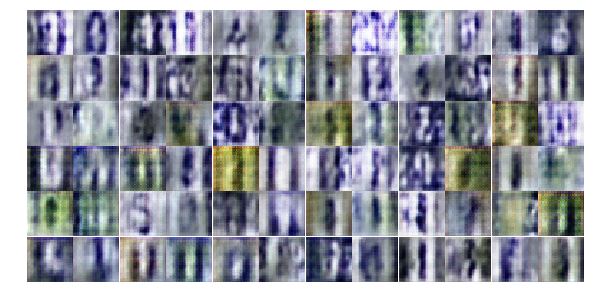

Epoch 3/25... Discriminator Loss: 1.1023... Generator Loss: 1.0692
Epoch 3/25... Discriminator Loss: 1.3368... Generator Loss: 0.4503
Epoch 3/25... Discriminator Loss: 1.5364... Generator Loss: 0.6194
Epoch 3/25... Discriminator Loss: 1.0655... Generator Loss: 0.8842
Epoch 3/25... Discriminator Loss: 1.1619... Generator Loss: 0.8817
Epoch 3/25... Discriminator Loss: 1.0056... Generator Loss: 0.9510
Epoch 3/25... Discriminator Loss: 1.2114... Generator Loss: 0.5944
Epoch 3/25... Discriminator Loss: 1.1890... Generator Loss: 0.8308
Epoch 3/25... Discriminator Loss: 0.9924... Generator Loss: 1.1109
Epoch 3/25... Discriminator Loss: 0.9462... Generator Loss: 1.0723


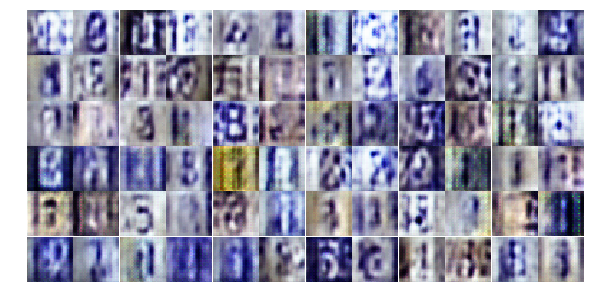

Epoch 3/25... Discriminator Loss: 1.0603... Generator Loss: 1.0929
Epoch 4/25... Discriminator Loss: 1.3259... Generator Loss: 0.8030
Epoch 4/25... Discriminator Loss: 1.1177... Generator Loss: 1.2036
Epoch 4/25... Discriminator Loss: 1.0447... Generator Loss: 0.6867
Epoch 4/25... Discriminator Loss: 1.4765... Generator Loss: 2.0334
Epoch 4/25... Discriminator Loss: 1.1308... Generator Loss: 0.9440
Epoch 4/25... Discriminator Loss: 1.3215... Generator Loss: 0.7313
Epoch 4/25... Discriminator Loss: 1.5134... Generator Loss: 0.3759
Epoch 4/25... Discriminator Loss: 1.0556... Generator Loss: 1.2307
Epoch 4/25... Discriminator Loss: 1.1293... Generator Loss: 1.0634


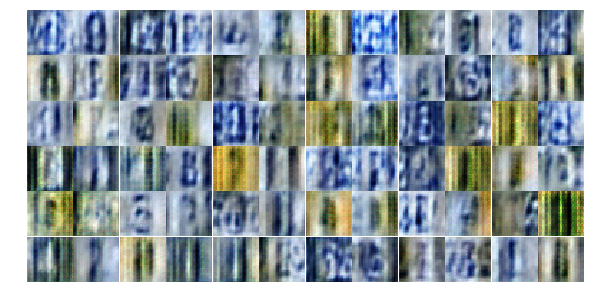

Epoch 4/25... Discriminator Loss: 1.1286... Generator Loss: 0.7836
Epoch 4/25... Discriminator Loss: 1.2214... Generator Loss: 0.5919
Epoch 4/25... Discriminator Loss: 1.0444... Generator Loss: 1.1172
Epoch 4/25... Discriminator Loss: 1.0960... Generator Loss: 0.8176
Epoch 4/25... Discriminator Loss: 1.7061... Generator Loss: 1.4342
Epoch 4/25... Discriminator Loss: 1.1520... Generator Loss: 0.6674
Epoch 4/25... Discriminator Loss: 1.1674... Generator Loss: 0.8245
Epoch 4/25... Discriminator Loss: 1.1554... Generator Loss: 0.9754
Epoch 4/25... Discriminator Loss: 1.0485... Generator Loss: 0.9200
Epoch 4/25... Discriminator Loss: 1.1775... Generator Loss: 1.4768


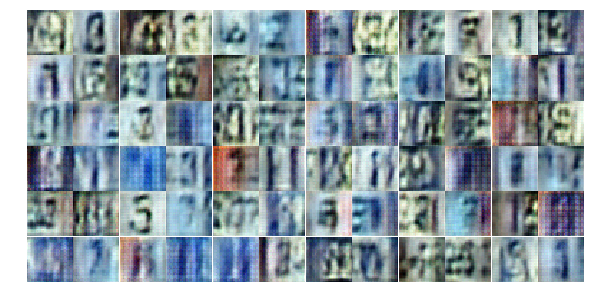

Epoch 4/25... Discriminator Loss: 1.1156... Generator Loss: 0.6737
Epoch 4/25... Discriminator Loss: 1.2008... Generator Loss: 1.9412
Epoch 4/25... Discriminator Loss: 0.9862... Generator Loss: 0.8816
Epoch 4/25... Discriminator Loss: 1.0556... Generator Loss: 0.7374
Epoch 4/25... Discriminator Loss: 1.1304... Generator Loss: 0.8072
Epoch 4/25... Discriminator Loss: 1.1373... Generator Loss: 1.4763
Epoch 4/25... Discriminator Loss: 1.1282... Generator Loss: 0.9539
Epoch 4/25... Discriminator Loss: 0.9967... Generator Loss: 0.8366
Epoch 4/25... Discriminator Loss: 1.3195... Generator Loss: 0.4619
Epoch 4/25... Discriminator Loss: 1.1755... Generator Loss: 0.6079


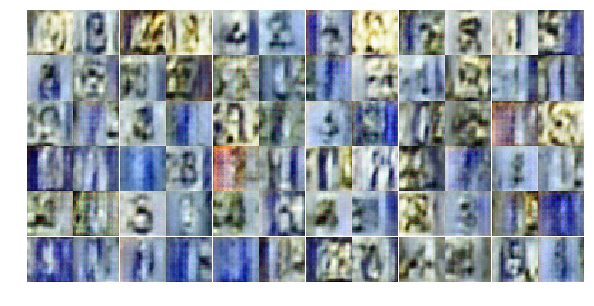

Epoch 4/25... Discriminator Loss: 1.0793... Generator Loss: 0.8213
Epoch 4/25... Discriminator Loss: 1.0817... Generator Loss: 0.9454
Epoch 4/25... Discriminator Loss: 1.1116... Generator Loss: 0.6648
Epoch 4/25... Discriminator Loss: 1.0327... Generator Loss: 0.8748
Epoch 4/25... Discriminator Loss: 1.1392... Generator Loss: 0.8392
Epoch 4/25... Discriminator Loss: 1.0226... Generator Loss: 1.0015
Epoch 4/25... Discriminator Loss: 1.4893... Generator Loss: 1.6152
Epoch 4/25... Discriminator Loss: 1.1307... Generator Loss: 0.6579
Epoch 4/25... Discriminator Loss: 1.0040... Generator Loss: 0.8627
Epoch 4/25... Discriminator Loss: 1.0031... Generator Loss: 0.9028


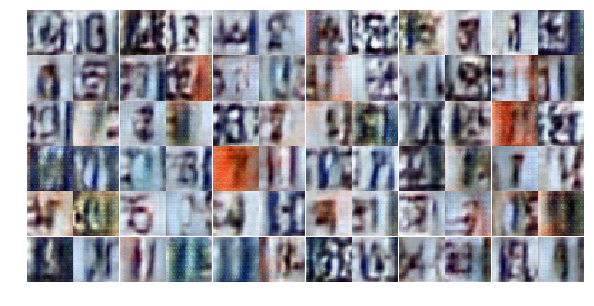

Epoch 4/25... Discriminator Loss: 1.2440... Generator Loss: 1.0186
Epoch 4/25... Discriminator Loss: 0.9138... Generator Loss: 0.9511
Epoch 4/25... Discriminator Loss: 1.0522... Generator Loss: 0.9504
Epoch 4/25... Discriminator Loss: 1.0999... Generator Loss: 0.8284
Epoch 4/25... Discriminator Loss: 0.9970... Generator Loss: 0.9128
Epoch 4/25... Discriminator Loss: 1.0556... Generator Loss: 1.4065
Epoch 4/25... Discriminator Loss: 1.4040... Generator Loss: 0.4454
Epoch 4/25... Discriminator Loss: 1.4704... Generator Loss: 1.4217
Epoch 4/25... Discriminator Loss: 1.3102... Generator Loss: 0.5894
Epoch 4/25... Discriminator Loss: 1.2320... Generator Loss: 1.2757


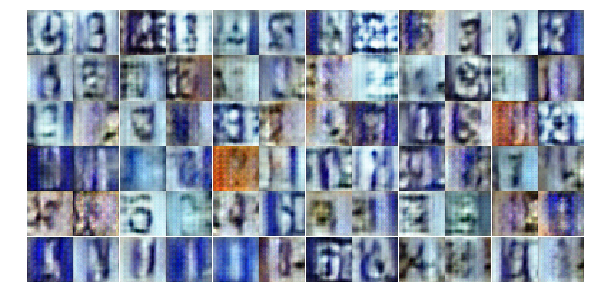

Epoch 4/25... Discriminator Loss: 1.2830... Generator Loss: 0.5267
Epoch 4/25... Discriminator Loss: 1.2216... Generator Loss: 0.6698
Epoch 4/25... Discriminator Loss: 1.2902... Generator Loss: 0.5405
Epoch 4/25... Discriminator Loss: 1.0107... Generator Loss: 1.2216
Epoch 4/25... Discriminator Loss: 1.3685... Generator Loss: 1.1260
Epoch 4/25... Discriminator Loss: 1.3146... Generator Loss: 0.5042
Epoch 4/25... Discriminator Loss: 1.1081... Generator Loss: 1.0810
Epoch 4/25... Discriminator Loss: 1.1593... Generator Loss: 0.7482
Epoch 4/25... Discriminator Loss: 1.2442... Generator Loss: 0.8058
Epoch 5/25... Discriminator Loss: 1.0554... Generator Loss: 0.7721


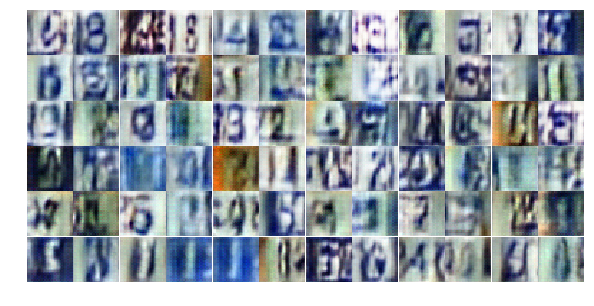

Epoch 5/25... Discriminator Loss: 1.4752... Generator Loss: 0.3774
Epoch 5/25... Discriminator Loss: 1.1129... Generator Loss: 1.2684
Epoch 5/25... Discriminator Loss: 1.3339... Generator Loss: 1.2695
Epoch 5/25... Discriminator Loss: 1.1544... Generator Loss: 0.9617
Epoch 5/25... Discriminator Loss: 1.0825... Generator Loss: 1.0281
Epoch 5/25... Discriminator Loss: 1.4044... Generator Loss: 0.4253
Epoch 5/25... Discriminator Loss: 1.2588... Generator Loss: 0.9574
Epoch 5/25... Discriminator Loss: 1.1076... Generator Loss: 0.6621
Epoch 5/25... Discriminator Loss: 1.2877... Generator Loss: 1.5750
Epoch 5/25... Discriminator Loss: 1.2748... Generator Loss: 0.6013


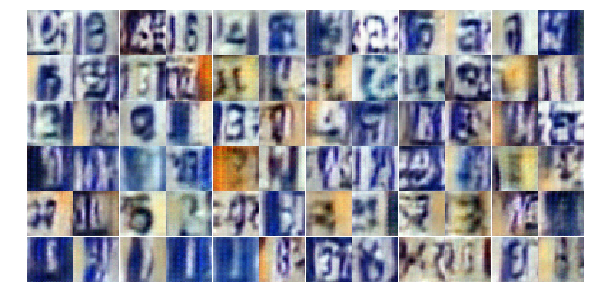

Epoch 5/25... Discriminator Loss: 1.1494... Generator Loss: 0.7288
Epoch 5/25... Discriminator Loss: 1.4843... Generator Loss: 0.4522
Epoch 5/25... Discriminator Loss: 0.9910... Generator Loss: 0.9430
Epoch 5/25... Discriminator Loss: 1.6779... Generator Loss: 0.3162
Epoch 5/25... Discriminator Loss: 1.0378... Generator Loss: 1.1454
Epoch 5/25... Discriminator Loss: 1.1860... Generator Loss: 1.2571
Epoch 5/25... Discriminator Loss: 1.1210... Generator Loss: 1.1140
Epoch 5/25... Discriminator Loss: 1.5129... Generator Loss: 0.3848
Epoch 5/25... Discriminator Loss: 0.9105... Generator Loss: 1.1712
Epoch 5/25... Discriminator Loss: 1.2367... Generator Loss: 0.6467


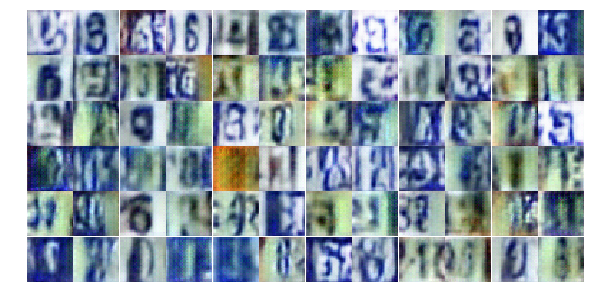

Epoch 5/25... Discriminator Loss: 1.1373... Generator Loss: 0.6071
Epoch 5/25... Discriminator Loss: 1.2853... Generator Loss: 0.6060
Epoch 5/25... Discriminator Loss: 1.1742... Generator Loss: 0.7640
Epoch 5/25... Discriminator Loss: 1.1883... Generator Loss: 1.2822
Epoch 5/25... Discriminator Loss: 1.2880... Generator Loss: 0.6215
Epoch 5/25... Discriminator Loss: 1.1757... Generator Loss: 0.6084
Epoch 5/25... Discriminator Loss: 1.3769... Generator Loss: 0.4523
Epoch 5/25... Discriminator Loss: 1.2224... Generator Loss: 0.8658
Epoch 5/25... Discriminator Loss: 1.4505... Generator Loss: 0.6302
Epoch 5/25... Discriminator Loss: 1.1088... Generator Loss: 0.8815


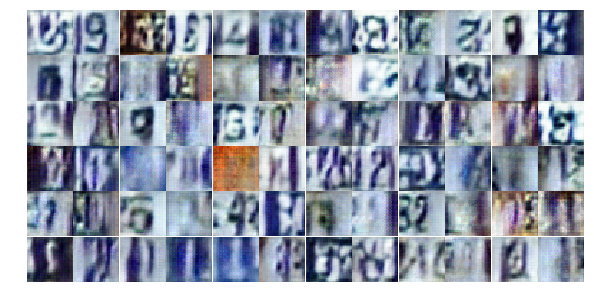

Epoch 5/25... Discriminator Loss: 1.3229... Generator Loss: 0.8858
Epoch 5/25... Discriminator Loss: 1.0541... Generator Loss: 1.1847
Epoch 5/25... Discriminator Loss: 1.1751... Generator Loss: 1.2372
Epoch 5/25... Discriminator Loss: 1.1209... Generator Loss: 1.0073
Epoch 5/25... Discriminator Loss: 0.8892... Generator Loss: 0.9064
Epoch 5/25... Discriminator Loss: 1.1643... Generator Loss: 0.7463
Epoch 5/25... Discriminator Loss: 1.2506... Generator Loss: 0.7686
Epoch 5/25... Discriminator Loss: 0.9602... Generator Loss: 1.0598
Epoch 5/25... Discriminator Loss: 1.1477... Generator Loss: 0.7471
Epoch 5/25... Discriminator Loss: 1.4914... Generator Loss: 0.3361


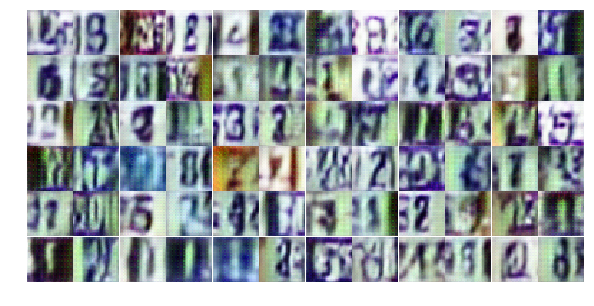

Epoch 5/25... Discriminator Loss: 1.1169... Generator Loss: 0.6319
Epoch 5/25... Discriminator Loss: 1.2866... Generator Loss: 0.5298
Epoch 5/25... Discriminator Loss: 1.3108... Generator Loss: 1.3322
Epoch 5/25... Discriminator Loss: 1.2073... Generator Loss: 1.4650
Epoch 5/25... Discriminator Loss: 1.7098... Generator Loss: 0.7535
Epoch 5/25... Discriminator Loss: 1.3005... Generator Loss: 0.5470
Epoch 5/25... Discriminator Loss: 1.2294... Generator Loss: 0.7735
Epoch 5/25... Discriminator Loss: 1.1216... Generator Loss: 0.7416
Epoch 5/25... Discriminator Loss: 1.1612... Generator Loss: 0.6587
Epoch 5/25... Discriminator Loss: 1.1228... Generator Loss: 0.9148


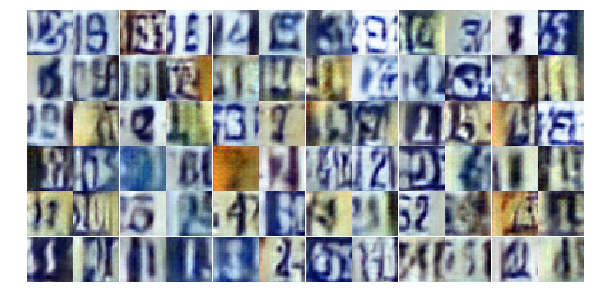

Epoch 5/25... Discriminator Loss: 1.2162... Generator Loss: 0.7035
Epoch 5/25... Discriminator Loss: 1.1349... Generator Loss: 0.7541
Epoch 5/25... Discriminator Loss: 1.2141... Generator Loss: 0.6386
Epoch 5/25... Discriminator Loss: 1.0206... Generator Loss: 0.7802
Epoch 5/25... Discriminator Loss: 1.1541... Generator Loss: 0.7744
Epoch 5/25... Discriminator Loss: 1.2216... Generator Loss: 0.5270
Epoch 6/25... Discriminator Loss: 1.4906... Generator Loss: 0.5217
Epoch 6/25... Discriminator Loss: 0.9991... Generator Loss: 0.8786
Epoch 6/25... Discriminator Loss: 1.3596... Generator Loss: 0.4305
Epoch 6/25... Discriminator Loss: 1.2227... Generator Loss: 0.7238


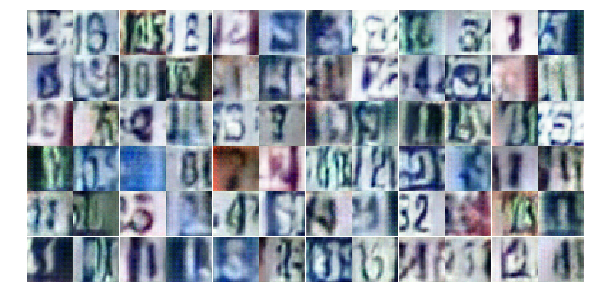

Epoch 6/25... Discriminator Loss: 1.1774... Generator Loss: 0.6839
Epoch 6/25... Discriminator Loss: 1.0866... Generator Loss: 1.3091
Epoch 6/25... Discriminator Loss: 1.2223... Generator Loss: 1.3138
Epoch 6/25... Discriminator Loss: 1.1658... Generator Loss: 0.7866
Epoch 6/25... Discriminator Loss: 1.1709... Generator Loss: 0.6897
Epoch 6/25... Discriminator Loss: 1.2338... Generator Loss: 0.7048
Epoch 6/25... Discriminator Loss: 1.0399... Generator Loss: 0.7578
Epoch 6/25... Discriminator Loss: 1.1707... Generator Loss: 1.2126
Epoch 6/25... Discriminator Loss: 1.0875... Generator Loss: 0.8070
Epoch 6/25... Discriminator Loss: 1.3117... Generator Loss: 0.5033


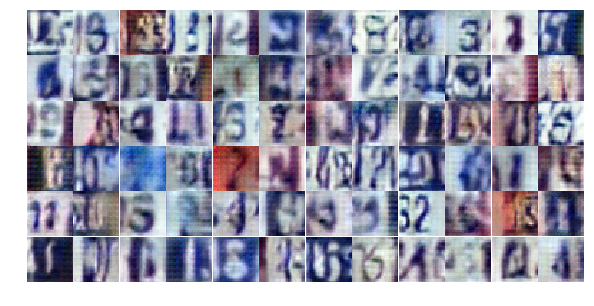

Epoch 6/25... Discriminator Loss: 1.0047... Generator Loss: 0.8815
Epoch 6/25... Discriminator Loss: 1.4421... Generator Loss: 0.4131
Epoch 6/25... Discriminator Loss: 1.1647... Generator Loss: 0.6480
Epoch 6/25... Discriminator Loss: 0.8872... Generator Loss: 0.9488
Epoch 6/25... Discriminator Loss: 0.8729... Generator Loss: 1.2858
Epoch 6/25... Discriminator Loss: 1.1466... Generator Loss: 0.8395
Epoch 6/25... Discriminator Loss: 1.3354... Generator Loss: 0.5806
Epoch 6/25... Discriminator Loss: 1.1283... Generator Loss: 0.6062
Epoch 6/25... Discriminator Loss: 1.1397... Generator Loss: 0.6453
Epoch 6/25... Discriminator Loss: 1.3310... Generator Loss: 0.9478


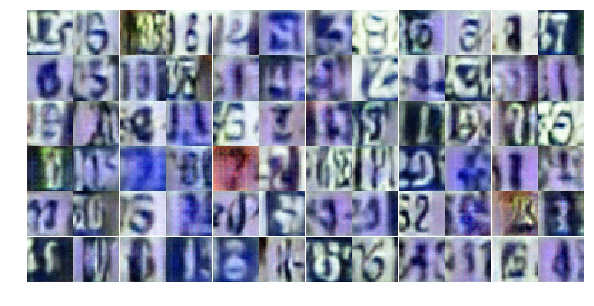

Epoch 6/25... Discriminator Loss: 1.2257... Generator Loss: 0.5135
Epoch 6/25... Discriminator Loss: 1.0971... Generator Loss: 0.8906
Epoch 6/25... Discriminator Loss: 1.2888... Generator Loss: 0.4883
Epoch 6/25... Discriminator Loss: 1.2801... Generator Loss: 0.6600
Epoch 6/25... Discriminator Loss: 1.1601... Generator Loss: 1.3580
Epoch 6/25... Discriminator Loss: 1.4635... Generator Loss: 0.3850
Epoch 6/25... Discriminator Loss: 1.3143... Generator Loss: 0.4693
Epoch 6/25... Discriminator Loss: 0.8632... Generator Loss: 1.4364
Epoch 6/25... Discriminator Loss: 0.9258... Generator Loss: 0.8872
Epoch 6/25... Discriminator Loss: 1.5998... Generator Loss: 0.6766


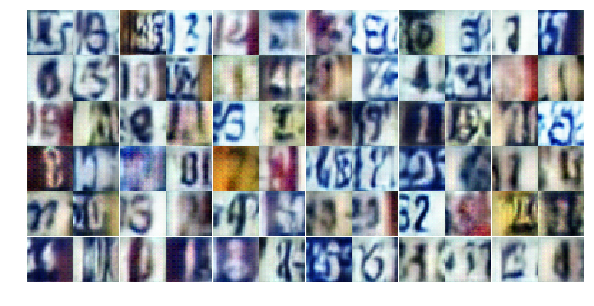

Epoch 6/25... Discriminator Loss: 1.3134... Generator Loss: 0.5277
Epoch 6/25... Discriminator Loss: 1.1081... Generator Loss: 1.1163
Epoch 6/25... Discriminator Loss: 1.2690... Generator Loss: 0.5071
Epoch 6/25... Discriminator Loss: 1.2976... Generator Loss: 0.5134
Epoch 6/25... Discriminator Loss: 1.1738... Generator Loss: 0.6669
Epoch 6/25... Discriminator Loss: 1.4275... Generator Loss: 0.4430
Epoch 6/25... Discriminator Loss: 1.1429... Generator Loss: 0.6950
Epoch 6/25... Discriminator Loss: 0.8452... Generator Loss: 1.4118
Epoch 6/25... Discriminator Loss: 1.4250... Generator Loss: 0.4175
Epoch 6/25... Discriminator Loss: 0.7088... Generator Loss: 1.2939


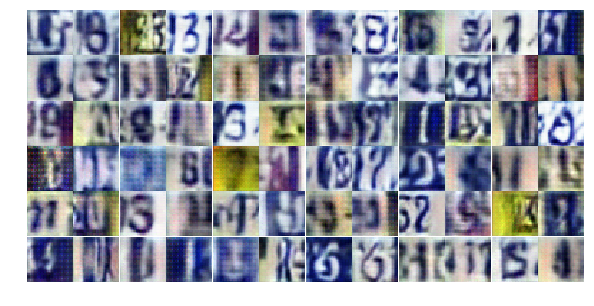

Epoch 6/25... Discriminator Loss: 1.5079... Generator Loss: 1.3788
Epoch 6/25... Discriminator Loss: 1.4301... Generator Loss: 0.3959
Epoch 6/25... Discriminator Loss: 1.4812... Generator Loss: 0.4098
Epoch 6/25... Discriminator Loss: 1.2179... Generator Loss: 1.1454
Epoch 6/25... Discriminator Loss: 1.4417... Generator Loss: 0.4252
Epoch 6/25... Discriminator Loss: 1.0130... Generator Loss: 0.8434
Epoch 6/25... Discriminator Loss: 1.5278... Generator Loss: 0.4302
Epoch 6/25... Discriminator Loss: 1.1915... Generator Loss: 0.5309
Epoch 6/25... Discriminator Loss: 1.0382... Generator Loss: 1.2079
Epoch 6/25... Discriminator Loss: 1.5796... Generator Loss: 0.3307


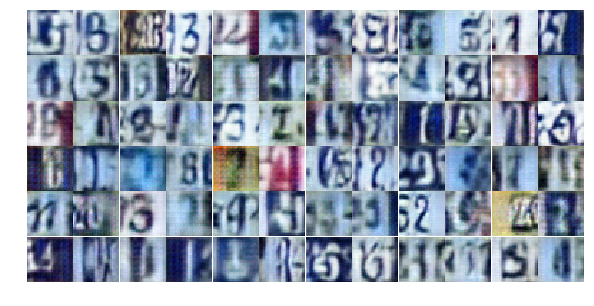

Epoch 6/25... Discriminator Loss: 1.0101... Generator Loss: 0.9380
Epoch 6/25... Discriminator Loss: 1.0687... Generator Loss: 1.0055
Epoch 6/25... Discriminator Loss: 1.2411... Generator Loss: 1.1418
Epoch 7/25... Discriminator Loss: 1.2240... Generator Loss: 0.6475
Epoch 7/25... Discriminator Loss: 1.2859... Generator Loss: 0.4733
Epoch 7/25... Discriminator Loss: 1.1585... Generator Loss: 1.0780
Epoch 7/25... Discriminator Loss: 0.9975... Generator Loss: 0.7891
Epoch 7/25... Discriminator Loss: 1.0604... Generator Loss: 0.7085
Epoch 7/25... Discriminator Loss: 0.8883... Generator Loss: 1.0860
Epoch 7/25... Discriminator Loss: 1.3398... Generator Loss: 0.4544


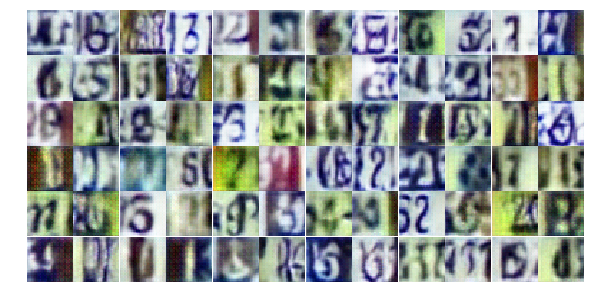

Epoch 7/25... Discriminator Loss: 0.8550... Generator Loss: 1.0455
Epoch 7/25... Discriminator Loss: 1.0859... Generator Loss: 0.7920
Epoch 7/25... Discriminator Loss: 1.2136... Generator Loss: 0.7666
Epoch 7/25... Discriminator Loss: 1.1870... Generator Loss: 0.6788
Epoch 7/25... Discriminator Loss: 0.7828... Generator Loss: 1.2782
Epoch 7/25... Discriminator Loss: 1.1046... Generator Loss: 0.5785
Epoch 7/25... Discriminator Loss: 1.4653... Generator Loss: 0.5453
Epoch 7/25... Discriminator Loss: 1.2160... Generator Loss: 1.0524
Epoch 7/25... Discriminator Loss: 1.7160... Generator Loss: 1.7988
Epoch 7/25... Discriminator Loss: 1.2131... Generator Loss: 0.5699


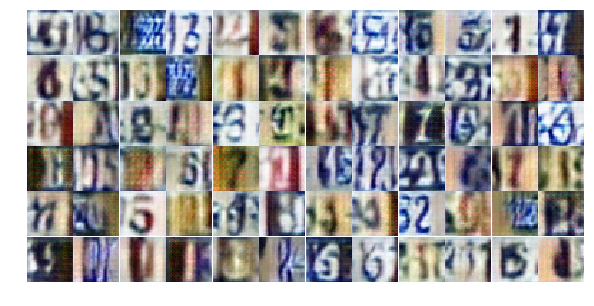

Epoch 7/25... Discriminator Loss: 1.3648... Generator Loss: 0.5254
Epoch 7/25... Discriminator Loss: 0.9301... Generator Loss: 0.8240
Epoch 7/25... Discriminator Loss: 1.0747... Generator Loss: 0.5863
Epoch 7/25... Discriminator Loss: 1.0708... Generator Loss: 0.7576
Epoch 7/25... Discriminator Loss: 0.8368... Generator Loss: 1.1303
Epoch 7/25... Discriminator Loss: 0.9046... Generator Loss: 1.2226
Epoch 7/25... Discriminator Loss: 0.7542... Generator Loss: 1.3261
Epoch 7/25... Discriminator Loss: 1.5296... Generator Loss: 0.3641
Epoch 7/25... Discriminator Loss: 0.6874... Generator Loss: 1.1418
Epoch 7/25... Discriminator Loss: 1.1177... Generator Loss: 1.1623


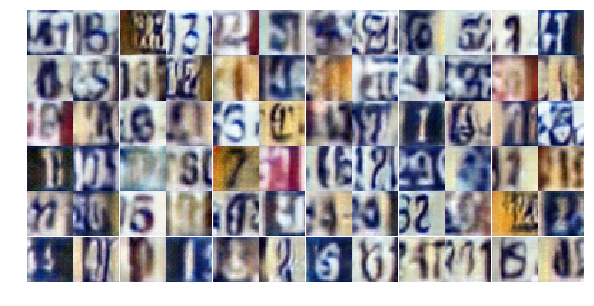

Epoch 7/25... Discriminator Loss: 1.5587... Generator Loss: 0.3420
Epoch 7/25... Discriminator Loss: 1.0302... Generator Loss: 0.6873
Epoch 7/25... Discriminator Loss: 1.1370... Generator Loss: 0.5699
Epoch 7/25... Discriminator Loss: 1.5614... Generator Loss: 0.3286
Epoch 7/25... Discriminator Loss: 1.2545... Generator Loss: 0.5230
Epoch 7/25... Discriminator Loss: 1.0865... Generator Loss: 0.9442
Epoch 7/25... Discriminator Loss: 0.9441... Generator Loss: 0.8845
Epoch 7/25... Discriminator Loss: 1.2764... Generator Loss: 0.4863
Epoch 7/25... Discriminator Loss: 1.2777... Generator Loss: 0.4814
Epoch 7/25... Discriminator Loss: 1.0738... Generator Loss: 1.2188


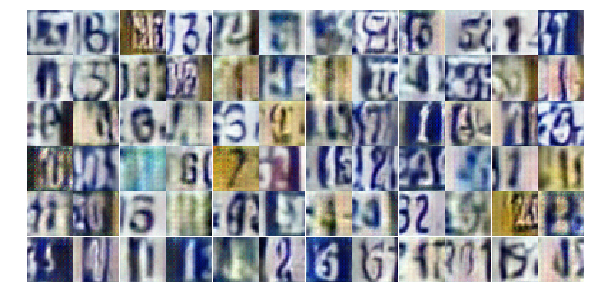

Epoch 7/25... Discriminator Loss: 1.1799... Generator Loss: 1.6313
Epoch 7/25... Discriminator Loss: 1.2994... Generator Loss: 0.6666
Epoch 7/25... Discriminator Loss: 0.8990... Generator Loss: 2.1653
Epoch 7/25... Discriminator Loss: 0.9897... Generator Loss: 0.8095
Epoch 7/25... Discriminator Loss: 0.6691... Generator Loss: 1.4976
Epoch 7/25... Discriminator Loss: 0.8697... Generator Loss: 1.5105
Epoch 7/25... Discriminator Loss: 1.5907... Generator Loss: 0.3355
Epoch 7/25... Discriminator Loss: 1.2189... Generator Loss: 0.5064
Epoch 7/25... Discriminator Loss: 0.9334... Generator Loss: 1.3888
Epoch 7/25... Discriminator Loss: 1.2774... Generator Loss: 0.4940


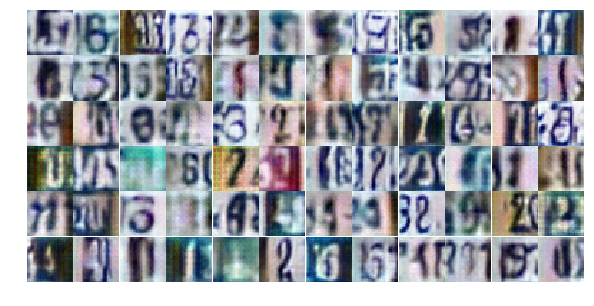

Epoch 7/25... Discriminator Loss: 0.8240... Generator Loss: 1.3713
Epoch 7/25... Discriminator Loss: 0.9764... Generator Loss: 1.2013
Epoch 7/25... Discriminator Loss: 0.8125... Generator Loss: 1.4552
Epoch 7/25... Discriminator Loss: 1.5256... Generator Loss: 0.3273
Epoch 7/25... Discriminator Loss: 1.0869... Generator Loss: 0.7235
Epoch 7/25... Discriminator Loss: 1.5101... Generator Loss: 0.3931
Epoch 7/25... Discriminator Loss: 1.7366... Generator Loss: 0.5305
Epoch 7/25... Discriminator Loss: 1.0621... Generator Loss: 0.9775
Epoch 7/25... Discriminator Loss: 1.3012... Generator Loss: 0.6652
Epoch 7/25... Discriminator Loss: 0.8205... Generator Loss: 0.9458


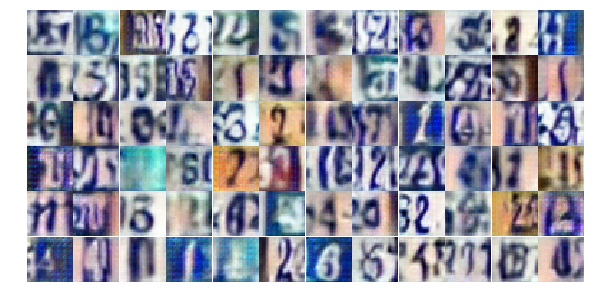

Epoch 7/25... Discriminator Loss: 1.0985... Generator Loss: 0.8130
Epoch 8/25... Discriminator Loss: 1.0827... Generator Loss: 0.6805
Epoch 8/25... Discriminator Loss: 1.6152... Generator Loss: 0.3106
Epoch 8/25... Discriminator Loss: 0.9906... Generator Loss: 0.9641
Epoch 8/25... Discriminator Loss: 0.8839... Generator Loss: 1.0968
Epoch 8/25... Discriminator Loss: 0.8206... Generator Loss: 1.3181
Epoch 8/25... Discriminator Loss: 1.3820... Generator Loss: 0.3941
Epoch 8/25... Discriminator Loss: 0.8689... Generator Loss: 0.9513
Epoch 8/25... Discriminator Loss: 1.2524... Generator Loss: 2.8614
Epoch 8/25... Discriminator Loss: 0.6948... Generator Loss: 1.3594


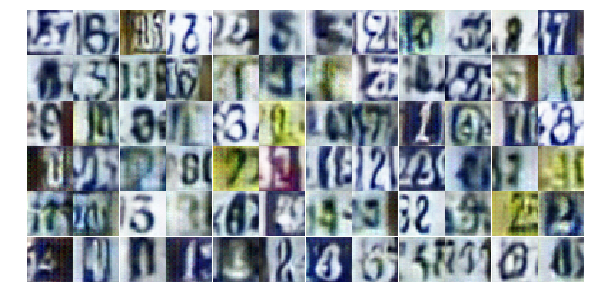

Epoch 8/25... Discriminator Loss: 0.4436... Generator Loss: 2.1371
Epoch 8/25... Discriminator Loss: 1.1582... Generator Loss: 0.6597
Epoch 8/25... Discriminator Loss: 0.7437... Generator Loss: 1.2575
Epoch 8/25... Discriminator Loss: 0.7597... Generator Loss: 1.4688
Epoch 8/25... Discriminator Loss: 1.2051... Generator Loss: 0.5822
Epoch 8/25... Discriminator Loss: 0.8465... Generator Loss: 0.8535
Epoch 8/25... Discriminator Loss: 0.8219... Generator Loss: 0.9189
Epoch 8/25... Discriminator Loss: 1.0804... Generator Loss: 1.2288
Epoch 8/25... Discriminator Loss: 1.4827... Generator Loss: 0.4199
Epoch 8/25... Discriminator Loss: 1.1268... Generator Loss: 0.7564


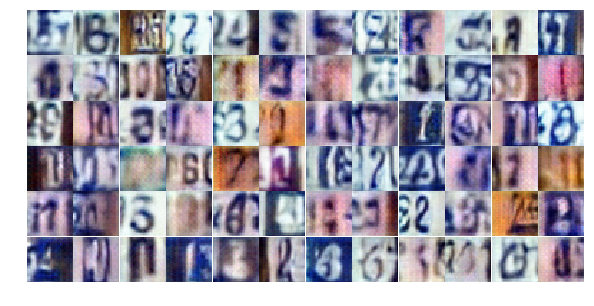

Epoch 8/25... Discriminator Loss: 0.9360... Generator Loss: 0.8145
Epoch 8/25... Discriminator Loss: 1.0003... Generator Loss: 1.2622
Epoch 8/25... Discriminator Loss: 1.0959... Generator Loss: 1.5404
Epoch 8/25... Discriminator Loss: 0.9596... Generator Loss: 0.7564
Epoch 8/25... Discriminator Loss: 0.7078... Generator Loss: 1.2116
Epoch 8/25... Discriminator Loss: 1.1492... Generator Loss: 0.7818
Epoch 8/25... Discriminator Loss: 1.0786... Generator Loss: 0.7971
Epoch 8/25... Discriminator Loss: 0.6868... Generator Loss: 1.1023
Epoch 8/25... Discriminator Loss: 0.8820... Generator Loss: 1.1128
Epoch 8/25... Discriminator Loss: 1.0932... Generator Loss: 0.6826


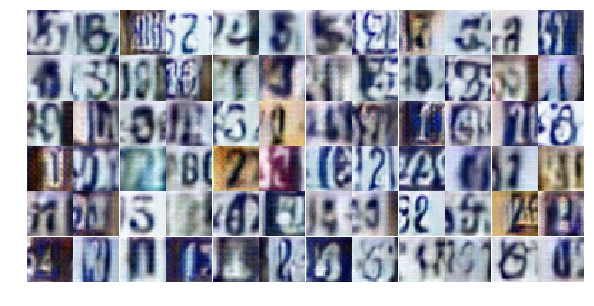

Epoch 8/25... Discriminator Loss: 0.6774... Generator Loss: 1.6072
Epoch 8/25... Discriminator Loss: 0.8854... Generator Loss: 0.9084
Epoch 8/25... Discriminator Loss: 0.6147... Generator Loss: 1.2051
Epoch 8/25... Discriminator Loss: 0.7281... Generator Loss: 1.4617
Epoch 8/25... Discriminator Loss: 0.7267... Generator Loss: 0.9529
Epoch 8/25... Discriminator Loss: 0.5729... Generator Loss: 1.2436
Epoch 8/25... Discriminator Loss: 1.0589... Generator Loss: 1.1031
Epoch 8/25... Discriminator Loss: 0.8304... Generator Loss: 1.3931
Epoch 8/25... Discriminator Loss: 0.6530... Generator Loss: 1.6481
Epoch 8/25... Discriminator Loss: 0.7308... Generator Loss: 1.5464


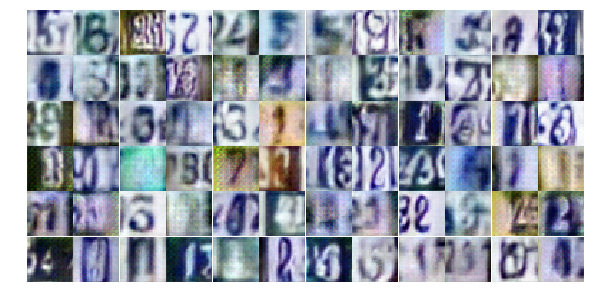

Epoch 8/25... Discriminator Loss: 1.3949... Generator Loss: 1.6910
Epoch 8/25... Discriminator Loss: 0.9438... Generator Loss: 3.2201
Epoch 8/25... Discriminator Loss: 0.6179... Generator Loss: 1.1818
Epoch 8/25... Discriminator Loss: 1.2390... Generator Loss: 0.7913
Epoch 8/25... Discriminator Loss: 0.8557... Generator Loss: 1.6147
Epoch 8/25... Discriminator Loss: 1.1910... Generator Loss: 0.5472
Epoch 8/25... Discriminator Loss: 1.0579... Generator Loss: 1.8369
Epoch 8/25... Discriminator Loss: 1.2852... Generator Loss: 0.8986
Epoch 8/25... Discriminator Loss: 0.9935... Generator Loss: 1.4983
Epoch 8/25... Discriminator Loss: 1.0682... Generator Loss: 1.3326


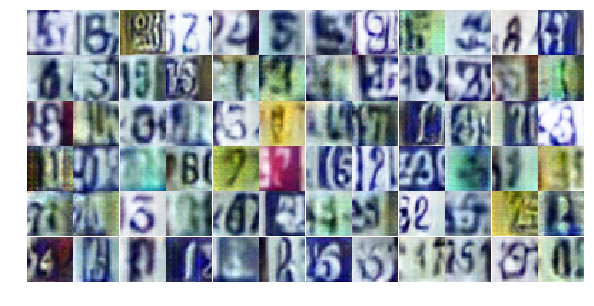

Epoch 8/25... Discriminator Loss: 1.0490... Generator Loss: 0.6620
Epoch 8/25... Discriminator Loss: 1.6969... Generator Loss: 0.2869
Epoch 8/25... Discriminator Loss: 1.5003... Generator Loss: 0.4471
Epoch 8/25... Discriminator Loss: 0.8172... Generator Loss: 1.2426
Epoch 8/25... Discriminator Loss: 1.0577... Generator Loss: 1.1600
Epoch 8/25... Discriminator Loss: 0.8870... Generator Loss: 1.1266
Epoch 8/25... Discriminator Loss: 1.0232... Generator Loss: 1.2116
Epoch 8/25... Discriminator Loss: 0.5789... Generator Loss: 1.6202
Epoch 9/25... Discriminator Loss: 0.6926... Generator Loss: 1.1798
Epoch 9/25... Discriminator Loss: 0.8183... Generator Loss: 0.7687


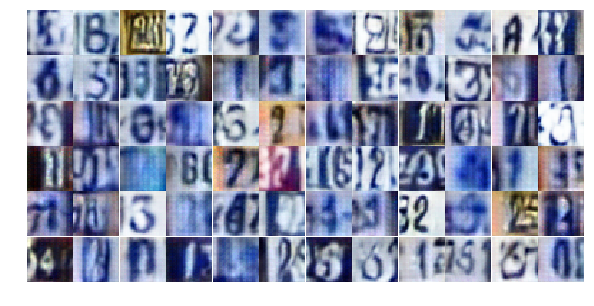

Epoch 9/25... Discriminator Loss: 1.3164... Generator Loss: 0.4147
Epoch 9/25... Discriminator Loss: 0.9483... Generator Loss: 1.8674
Epoch 9/25... Discriminator Loss: 1.1437... Generator Loss: 0.6743
Epoch 9/25... Discriminator Loss: 0.7987... Generator Loss: 1.1451
Epoch 9/25... Discriminator Loss: 0.6517... Generator Loss: 1.6655
Epoch 9/25... Discriminator Loss: 1.0344... Generator Loss: 2.9400
Epoch 9/25... Discriminator Loss: 0.8417... Generator Loss: 1.1620
Epoch 9/25... Discriminator Loss: 0.9017... Generator Loss: 0.9520
Epoch 9/25... Discriminator Loss: 0.9705... Generator Loss: 0.7322
Epoch 9/25... Discriminator Loss: 1.7977... Generator Loss: 0.8615


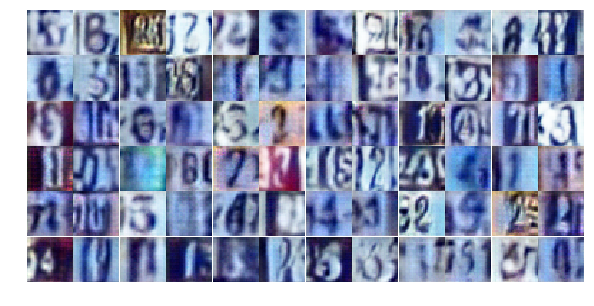

Epoch 9/25... Discriminator Loss: 1.4814... Generator Loss: 0.3767
Epoch 9/25... Discriminator Loss: 1.6037... Generator Loss: 0.3450
Epoch 9/25... Discriminator Loss: 0.7865... Generator Loss: 1.0070
Epoch 9/25... Discriminator Loss: 1.1722... Generator Loss: 0.5184
Epoch 9/25... Discriminator Loss: 0.5096... Generator Loss: 1.3800
Epoch 9/25... Discriminator Loss: 1.1797... Generator Loss: 0.6057
Epoch 9/25... Discriminator Loss: 1.6381... Generator Loss: 0.3306
Epoch 9/25... Discriminator Loss: 0.5643... Generator Loss: 1.2374
Epoch 9/25... Discriminator Loss: 1.3684... Generator Loss: 0.3865
Epoch 9/25... Discriminator Loss: 1.1951... Generator Loss: 0.5514


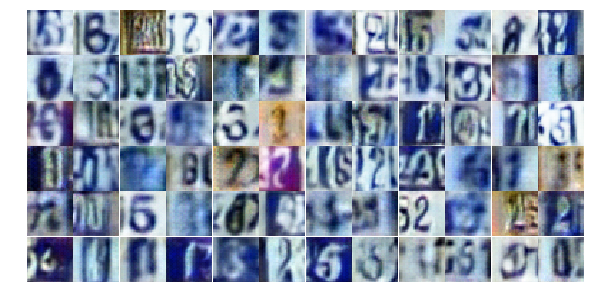

Epoch 9/25... Discriminator Loss: 1.4180... Generator Loss: 0.3876
Epoch 9/25... Discriminator Loss: 0.9822... Generator Loss: 0.8921
Epoch 9/25... Discriminator Loss: 0.9416... Generator Loss: 0.6637
Epoch 9/25... Discriminator Loss: 1.6775... Generator Loss: 0.2844
Epoch 9/25... Discriminator Loss: 0.5433... Generator Loss: 1.8100
Epoch 9/25... Discriminator Loss: 1.9232... Generator Loss: 0.2274
Epoch 9/25... Discriminator Loss: 1.5028... Generator Loss: 0.4415
Epoch 9/25... Discriminator Loss: 0.6222... Generator Loss: 1.4941
Epoch 9/25... Discriminator Loss: 0.6995... Generator Loss: 2.6779
Epoch 9/25... Discriminator Loss: 1.1164... Generator Loss: 0.5967


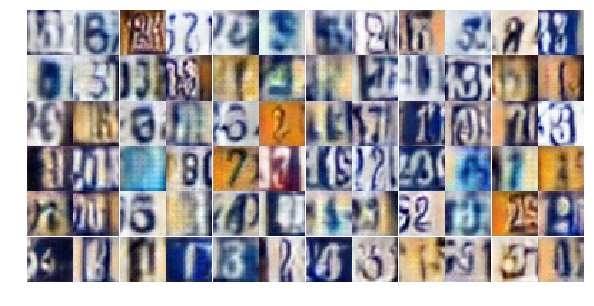

Epoch 9/25... Discriminator Loss: 0.9914... Generator Loss: 0.6660
Epoch 9/25... Discriminator Loss: 0.7443... Generator Loss: 1.1912
Epoch 9/25... Discriminator Loss: 0.8249... Generator Loss: 1.2383
Epoch 9/25... Discriminator Loss: 1.8700... Generator Loss: 0.2690
Epoch 9/25... Discriminator Loss: 0.6306... Generator Loss: 1.1860
Epoch 9/25... Discriminator Loss: 1.5496... Generator Loss: 0.4431
Epoch 9/25... Discriminator Loss: 0.8893... Generator Loss: 0.8127
Epoch 9/25... Discriminator Loss: 0.6825... Generator Loss: 1.3182
Epoch 9/25... Discriminator Loss: 1.3092... Generator Loss: 0.5056
Epoch 9/25... Discriminator Loss: 0.8326... Generator Loss: 0.9438


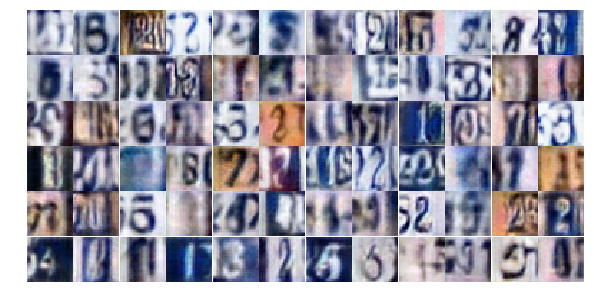

Epoch 9/25... Discriminator Loss: 0.5666... Generator Loss: 1.1708
Epoch 9/25... Discriminator Loss: 0.4148... Generator Loss: 1.7952
Epoch 9/25... Discriminator Loss: 2.4818... Generator Loss: 0.1881
Epoch 9/25... Discriminator Loss: 1.8442... Generator Loss: 1.0125
Epoch 9/25... Discriminator Loss: 1.4473... Generator Loss: 0.7784
Epoch 9/25... Discriminator Loss: 1.6006... Generator Loss: 0.8120
Epoch 9/25... Discriminator Loss: 1.5042... Generator Loss: 0.7689
Epoch 9/25... Discriminator Loss: 1.3149... Generator Loss: 0.8447
Epoch 9/25... Discriminator Loss: 1.3851... Generator Loss: 0.9033
Epoch 9/25... Discriminator Loss: 1.3661... Generator Loss: 0.8528


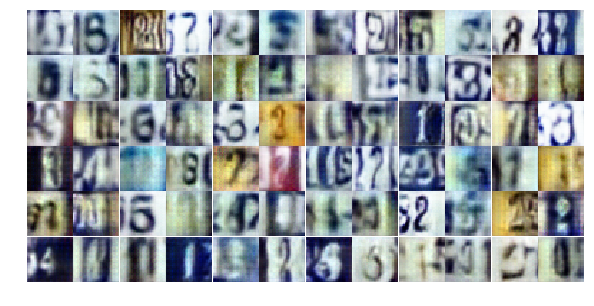

Epoch 9/25... Discriminator Loss: 1.3933... Generator Loss: 0.8808
Epoch 9/25... Discriminator Loss: 1.4514... Generator Loss: 0.7410
Epoch 9/25... Discriminator Loss: 1.4264... Generator Loss: 0.6942
Epoch 9/25... Discriminator Loss: 1.3578... Generator Loss: 0.7584
Epoch 9/25... Discriminator Loss: 1.4490... Generator Loss: 0.8194
Epoch 10/25... Discriminator Loss: 1.6301... Generator Loss: 0.5617
Epoch 10/25... Discriminator Loss: 1.3217... Generator Loss: 0.8381
Epoch 10/25... Discriminator Loss: 1.8242... Generator Loss: 0.5853
Epoch 10/25... Discriminator Loss: 1.2300... Generator Loss: 0.9614
Epoch 10/25... Discriminator Loss: 1.4631... Generator Loss: 0.7553


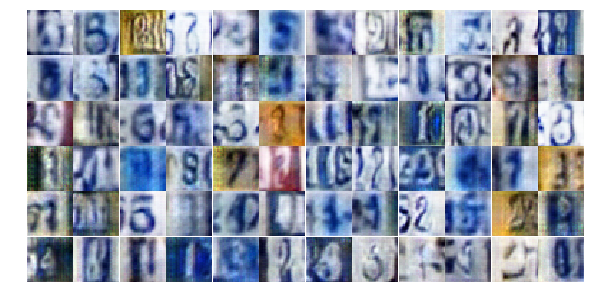

Epoch 10/25... Discriminator Loss: 1.0893... Generator Loss: 0.8365
Epoch 10/25... Discriminator Loss: 1.1666... Generator Loss: 0.9096
Epoch 10/25... Discriminator Loss: 0.9333... Generator Loss: 1.2831
Epoch 10/25... Discriminator Loss: 1.1494... Generator Loss: 0.9435
Epoch 10/25... Discriminator Loss: 1.1510... Generator Loss: 0.8929
Epoch 10/25... Discriminator Loss: 1.5299... Generator Loss: 1.0389
Epoch 10/25... Discriminator Loss: 1.0040... Generator Loss: 1.2459
Epoch 10/25... Discriminator Loss: 1.6493... Generator Loss: 0.3703
Epoch 10/25... Discriminator Loss: 1.5117... Generator Loss: 0.4538
Epoch 10/25... Discriminator Loss: 1.0444... Generator Loss: 1.0950


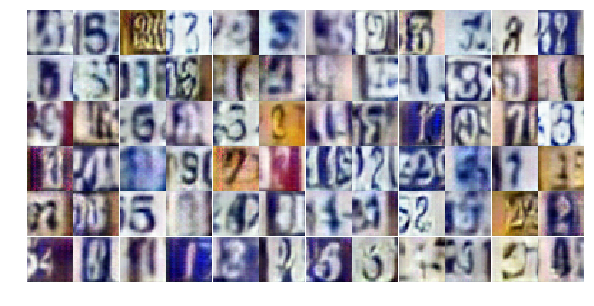

Epoch 10/25... Discriminator Loss: 1.2787... Generator Loss: 0.5774
Epoch 10/25... Discriminator Loss: 1.3857... Generator Loss: 0.6573
Epoch 10/25... Discriminator Loss: 1.0173... Generator Loss: 0.7013
Epoch 10/25... Discriminator Loss: 1.7837... Generator Loss: 0.2882
Epoch 10/25... Discriminator Loss: 0.8357... Generator Loss: 1.0322
Epoch 10/25... Discriminator Loss: 1.0626... Generator Loss: 0.6541
Epoch 10/25... Discriminator Loss: 1.3223... Generator Loss: 1.1300
Epoch 10/25... Discriminator Loss: 1.3518... Generator Loss: 0.4213
Epoch 10/25... Discriminator Loss: 1.2838... Generator Loss: 0.4798
Epoch 10/25... Discriminator Loss: 0.9114... Generator Loss: 1.5521


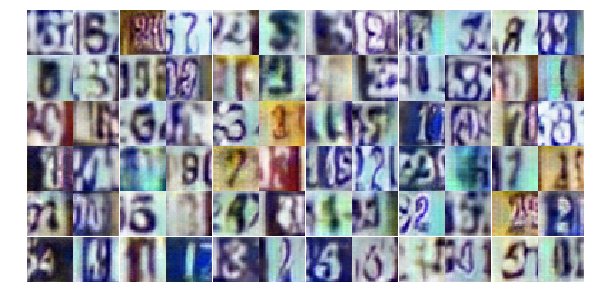

Epoch 10/25... Discriminator Loss: 1.2687... Generator Loss: 0.5110
Epoch 10/25... Discriminator Loss: 1.7747... Generator Loss: 0.2388
Epoch 10/25... Discriminator Loss: 0.9248... Generator Loss: 0.8933
Epoch 10/25... Discriminator Loss: 1.0417... Generator Loss: 1.4512
Epoch 10/25... Discriminator Loss: 1.5199... Generator Loss: 0.3634
Epoch 10/25... Discriminator Loss: 1.0063... Generator Loss: 0.9415
Epoch 10/25... Discriminator Loss: 0.9883... Generator Loss: 0.6845
Epoch 10/25... Discriminator Loss: 1.0142... Generator Loss: 0.7189
Epoch 10/25... Discriminator Loss: 0.9329... Generator Loss: 0.9843
Epoch 10/25... Discriminator Loss: 1.0201... Generator Loss: 0.6691


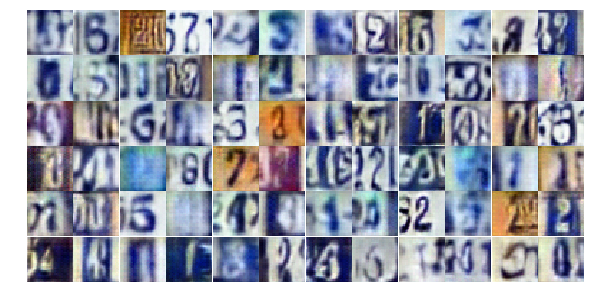

Epoch 10/25... Discriminator Loss: 0.6009... Generator Loss: 1.7155
Epoch 10/25... Discriminator Loss: 0.8461... Generator Loss: 1.0008
Epoch 10/25... Discriminator Loss: 1.6090... Generator Loss: 0.5567
Epoch 10/25... Discriminator Loss: 0.9390... Generator Loss: 1.3061
Epoch 10/25... Discriminator Loss: 0.9698... Generator Loss: 0.9359
Epoch 10/25... Discriminator Loss: 1.3941... Generator Loss: 0.4349
Epoch 10/25... Discriminator Loss: 1.1872... Generator Loss: 0.5187
Epoch 10/25... Discriminator Loss: 1.2181... Generator Loss: 0.4534
Epoch 10/25... Discriminator Loss: 0.5903... Generator Loss: 1.2840
Epoch 10/25... Discriminator Loss: 1.9440... Generator Loss: 2.5575


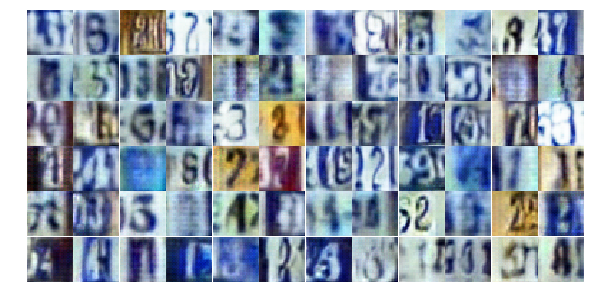

Epoch 10/25... Discriminator Loss: 0.8424... Generator Loss: 1.3377
Epoch 10/25... Discriminator Loss: 1.1467... Generator Loss: 0.5990
Epoch 10/25... Discriminator Loss: 1.1758... Generator Loss: 0.5807
Epoch 10/25... Discriminator Loss: 1.0453... Generator Loss: 1.0752
Epoch 10/25... Discriminator Loss: 0.8893... Generator Loss: 0.8225
Epoch 10/25... Discriminator Loss: 0.9183... Generator Loss: 0.7249
Epoch 10/25... Discriminator Loss: 0.5910... Generator Loss: 1.2318
Epoch 10/25... Discriminator Loss: 1.1294... Generator Loss: 0.5812
Epoch 10/25... Discriminator Loss: 0.2800... Generator Loss: 2.0707
Epoch 10/25... Discriminator Loss: 0.5833... Generator Loss: 1.2476


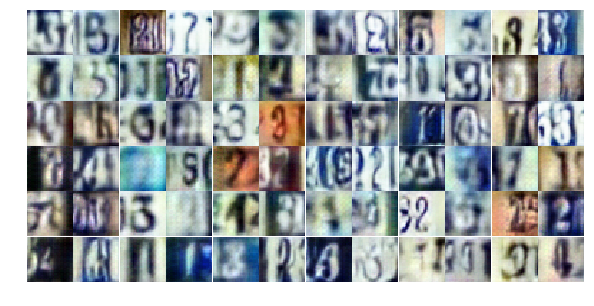

Epoch 10/25... Discriminator Loss: 0.7879... Generator Loss: 0.8085
Epoch 10/25... Discriminator Loss: 1.6408... Generator Loss: 0.3271
Epoch 10/25... Discriminator Loss: 0.9049... Generator Loss: 0.8287
Epoch 11/25... Discriminator Loss: 1.2761... Generator Loss: 0.6260
Epoch 11/25... Discriminator Loss: 0.6463... Generator Loss: 1.2165
Epoch 11/25... Discriminator Loss: 1.6281... Generator Loss: 0.3292
Epoch 11/25... Discriminator Loss: 0.9190... Generator Loss: 0.7473
Epoch 11/25... Discriminator Loss: 1.0065... Generator Loss: 0.6780
Epoch 11/25... Discriminator Loss: 1.6143... Generator Loss: 1.0066
Epoch 11/25... Discriminator Loss: 0.2435... Generator Loss: 3.3665


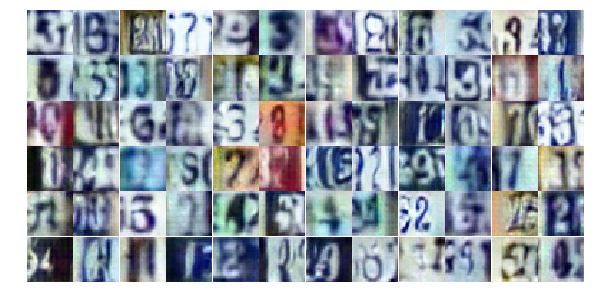

Epoch 11/25... Discriminator Loss: 0.5217... Generator Loss: 3.0858
Epoch 11/25... Discriminator Loss: 0.6086... Generator Loss: 1.0574
Epoch 11/25... Discriminator Loss: 1.4374... Generator Loss: 0.3673
Epoch 11/25... Discriminator Loss: 1.3614... Generator Loss: 0.6629
Epoch 11/25... Discriminator Loss: 0.6496... Generator Loss: 1.2808
Epoch 11/25... Discriminator Loss: 0.7748... Generator Loss: 2.8897
Epoch 11/25... Discriminator Loss: 1.1403... Generator Loss: 1.0428
Epoch 11/25... Discriminator Loss: 0.5452... Generator Loss: 1.1839
Epoch 11/25... Discriminator Loss: 1.0546... Generator Loss: 0.6023
Epoch 11/25... Discriminator Loss: 1.6367... Generator Loss: 0.3365


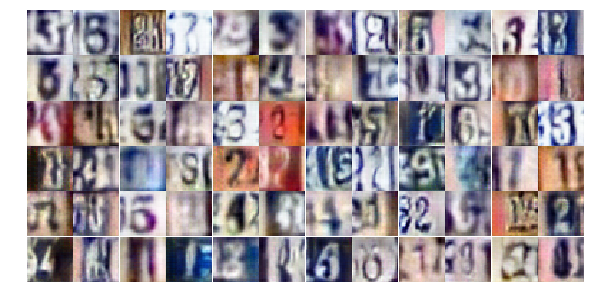

Epoch 11/25... Discriminator Loss: 1.3318... Generator Loss: 0.5660
Epoch 11/25... Discriminator Loss: 0.6640... Generator Loss: 1.4187
Epoch 11/25... Discriminator Loss: 1.5200... Generator Loss: 0.3565
Epoch 11/25... Discriminator Loss: 0.7093... Generator Loss: 1.2604
Epoch 11/25... Discriminator Loss: 1.1731... Generator Loss: 0.5071
Epoch 11/25... Discriminator Loss: 0.8200... Generator Loss: 1.0641
Epoch 11/25... Discriminator Loss: 0.8520... Generator Loss: 1.0295
Epoch 11/25... Discriminator Loss: 1.0356... Generator Loss: 0.8620
Epoch 11/25... Discriminator Loss: 0.6629... Generator Loss: 1.4161
Epoch 11/25... Discriminator Loss: 0.7861... Generator Loss: 1.6441


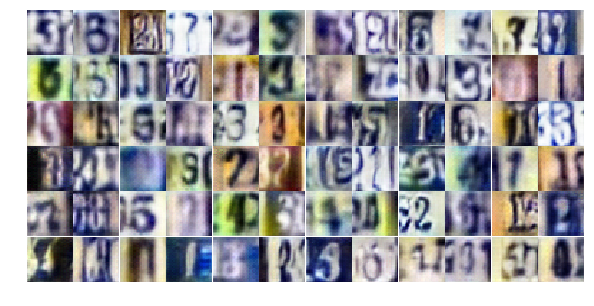

Epoch 11/25... Discriminator Loss: 0.5111... Generator Loss: 1.3253
Epoch 11/25... Discriminator Loss: 0.9637... Generator Loss: 0.7754
Epoch 11/25... Discriminator Loss: 0.8741... Generator Loss: 0.9551
Epoch 11/25... Discriminator Loss: 0.5948... Generator Loss: 1.7990
Epoch 11/25... Discriminator Loss: 1.8602... Generator Loss: 0.2440
Epoch 11/25... Discriminator Loss: 2.4437... Generator Loss: 0.1271
Epoch 11/25... Discriminator Loss: 1.7569... Generator Loss: 0.2981
Epoch 11/25... Discriminator Loss: 0.8954... Generator Loss: 0.7333
Epoch 11/25... Discriminator Loss: 1.0658... Generator Loss: 1.0707
Epoch 11/25... Discriminator Loss: 1.3122... Generator Loss: 0.4636


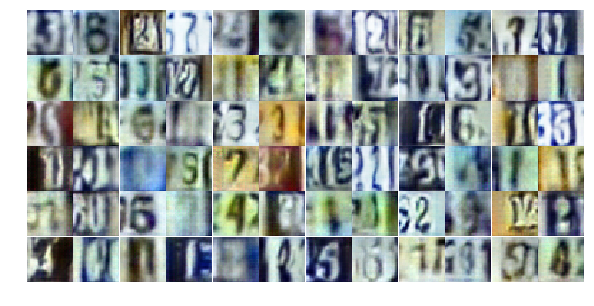

Epoch 11/25... Discriminator Loss: 0.8346... Generator Loss: 0.8609
Epoch 11/25... Discriminator Loss: 0.5658... Generator Loss: 1.4372
Epoch 11/25... Discriminator Loss: 0.9742... Generator Loss: 1.2981
Epoch 11/25... Discriminator Loss: 1.1557... Generator Loss: 0.7762
Epoch 11/25... Discriminator Loss: 1.2117... Generator Loss: 0.5502
Epoch 11/25... Discriminator Loss: 1.2375... Generator Loss: 0.4861
Epoch 11/25... Discriminator Loss: 0.6606... Generator Loss: 1.0991
Epoch 11/25... Discriminator Loss: 1.0143... Generator Loss: 0.6316
Epoch 11/25... Discriminator Loss: 1.6153... Generator Loss: 0.3327
Epoch 11/25... Discriminator Loss: 0.6964... Generator Loss: 1.1216


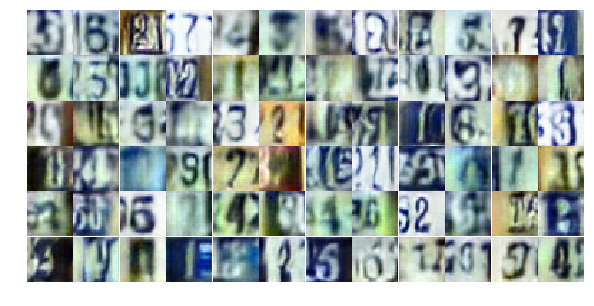

Epoch 11/25... Discriminator Loss: 0.9919... Generator Loss: 0.7187
Epoch 11/25... Discriminator Loss: 0.4357... Generator Loss: 1.8954
Epoch 11/25... Discriminator Loss: 0.5052... Generator Loss: 1.4622
Epoch 11/25... Discriminator Loss: 1.1563... Generator Loss: 1.2961
Epoch 11/25... Discriminator Loss: 1.2689... Generator Loss: 1.4224
Epoch 11/25... Discriminator Loss: 0.5179... Generator Loss: 1.4713
Epoch 11/25... Discriminator Loss: 0.5847... Generator Loss: 1.9038
Epoch 11/25... Discriminator Loss: 0.3732... Generator Loss: 2.0219
Epoch 11/25... Discriminator Loss: 0.9006... Generator Loss: 0.7979
Epoch 11/25... Discriminator Loss: 1.6723... Generator Loss: 0.3363


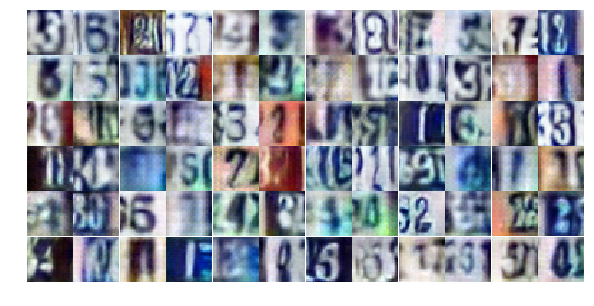

Epoch 12/25... Discriminator Loss: 1.2067... Generator Loss: 0.5971
Epoch 12/25... Discriminator Loss: 0.8353... Generator Loss: 1.4632
Epoch 12/25... Discriminator Loss: 1.4194... Generator Loss: 0.4135
Epoch 12/25... Discriminator Loss: 1.3567... Generator Loss: 0.4505
Epoch 12/25... Discriminator Loss: 0.5123... Generator Loss: 1.7891
Epoch 12/25... Discriminator Loss: 0.4974... Generator Loss: 2.4699
Epoch 12/25... Discriminator Loss: 0.9827... Generator Loss: 1.1773
Epoch 12/25... Discriminator Loss: 0.6993... Generator Loss: 1.1700
Epoch 12/25... Discriminator Loss: 0.9649... Generator Loss: 0.7000
Epoch 12/25... Discriminator Loss: 0.5111... Generator Loss: 1.3392


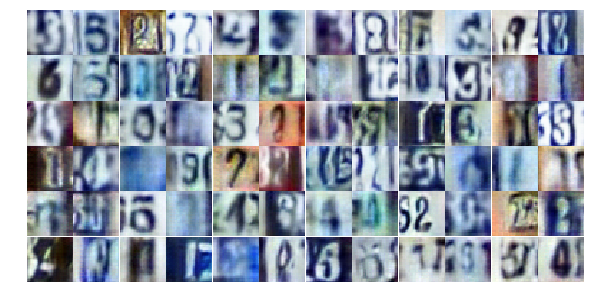

Epoch 12/25... Discriminator Loss: 1.0896... Generator Loss: 0.9510
Epoch 12/25... Discriminator Loss: 0.9930... Generator Loss: 0.7001
Epoch 12/25... Discriminator Loss: 0.6837... Generator Loss: 1.1111
Epoch 12/25... Discriminator Loss: 0.4798... Generator Loss: 1.7380
Epoch 12/25... Discriminator Loss: 0.9755... Generator Loss: 0.7607
Epoch 12/25... Discriminator Loss: 1.0848... Generator Loss: 1.1866
Epoch 12/25... Discriminator Loss: 2.0664... Generator Loss: 0.2969
Epoch 12/25... Discriminator Loss: 0.9315... Generator Loss: 1.3188
Epoch 12/25... Discriminator Loss: 0.9997... Generator Loss: 2.2628
Epoch 12/25... Discriminator Loss: 0.8517... Generator Loss: 1.1285


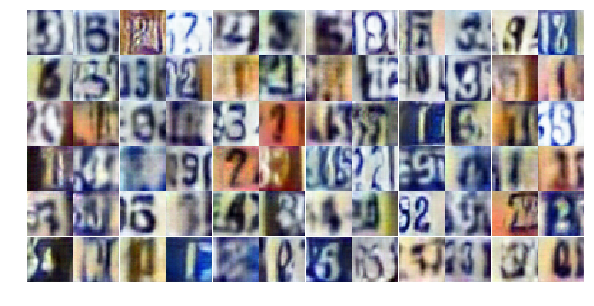

Epoch 12/25... Discriminator Loss: 0.5247... Generator Loss: 1.9078
Epoch 12/25... Discriminator Loss: 0.8974... Generator Loss: 1.8106
Epoch 12/25... Discriminator Loss: 1.0466... Generator Loss: 0.6131
Epoch 12/25... Discriminator Loss: 0.8993... Generator Loss: 1.0025
Epoch 12/25... Discriminator Loss: 0.5465... Generator Loss: 2.4354
Epoch 12/25... Discriminator Loss: 0.5878... Generator Loss: 1.2913
Epoch 12/25... Discriminator Loss: 2.2152... Generator Loss: 0.1813
Epoch 12/25... Discriminator Loss: 0.7332... Generator Loss: 0.9945
Epoch 12/25... Discriminator Loss: 0.6789... Generator Loss: 2.4794
Epoch 12/25... Discriminator Loss: 1.0076... Generator Loss: 0.7399


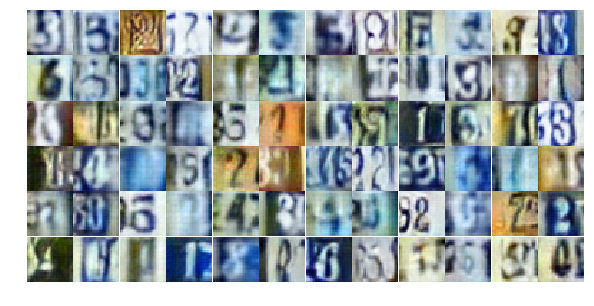

Epoch 12/25... Discriminator Loss: 0.4862... Generator Loss: 1.7288
Epoch 12/25... Discriminator Loss: 0.7695... Generator Loss: 1.1940
Epoch 12/25... Discriminator Loss: 0.8308... Generator Loss: 0.8451
Epoch 12/25... Discriminator Loss: 1.8499... Generator Loss: 0.2939
Epoch 12/25... Discriminator Loss: 0.7600... Generator Loss: 0.9500
Epoch 12/25... Discriminator Loss: 0.7554... Generator Loss: 1.9369
Epoch 12/25... Discriminator Loss: 1.6261... Generator Loss: 0.8454
Epoch 12/25... Discriminator Loss: 0.9923... Generator Loss: 1.1745
Epoch 12/25... Discriminator Loss: 0.9311... Generator Loss: 0.8744
Epoch 12/25... Discriminator Loss: 0.9886... Generator Loss: 0.8920


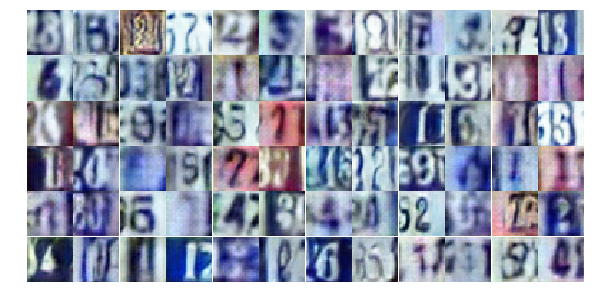

Epoch 12/25... Discriminator Loss: 0.9119... Generator Loss: 1.9389
Epoch 12/25... Discriminator Loss: 0.6919... Generator Loss: 1.2112
Epoch 12/25... Discriminator Loss: 0.5267... Generator Loss: 1.3182
Epoch 12/25... Discriminator Loss: 1.1411... Generator Loss: 0.5923
Epoch 12/25... Discriminator Loss: 1.1991... Generator Loss: 0.5743
Epoch 12/25... Discriminator Loss: 1.3757... Generator Loss: 0.4678
Epoch 12/25... Discriminator Loss: 1.1574... Generator Loss: 0.6698
Epoch 12/25... Discriminator Loss: 0.9206... Generator Loss: 0.8946
Epoch 12/25... Discriminator Loss: 0.5297... Generator Loss: 1.4578
Epoch 12/25... Discriminator Loss: 0.5841... Generator Loss: 1.1644


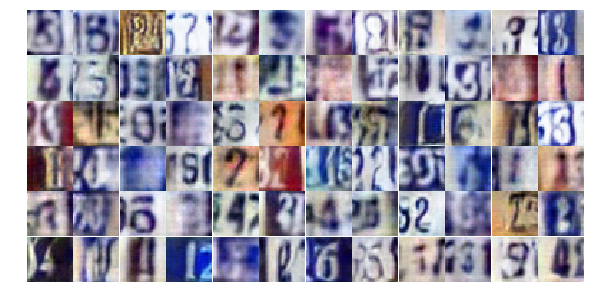

Epoch 12/25... Discriminator Loss: 1.4009... Generator Loss: 0.4140
Epoch 12/25... Discriminator Loss: 0.5490... Generator Loss: 1.3123
Epoch 12/25... Discriminator Loss: 1.0408... Generator Loss: 0.9395
Epoch 12/25... Discriminator Loss: 1.4109... Generator Loss: 0.4084
Epoch 12/25... Discriminator Loss: 0.7731... Generator Loss: 0.9919
Epoch 12/25... Discriminator Loss: 1.3082... Generator Loss: 2.0460
Epoch 12/25... Discriminator Loss: 0.9923... Generator Loss: 0.7341
Epoch 13/25... Discriminator Loss: 0.5765... Generator Loss: 1.3186
Epoch 13/25... Discriminator Loss: 0.7804... Generator Loss: 1.3455
Epoch 13/25... Discriminator Loss: 0.5740... Generator Loss: 1.7049


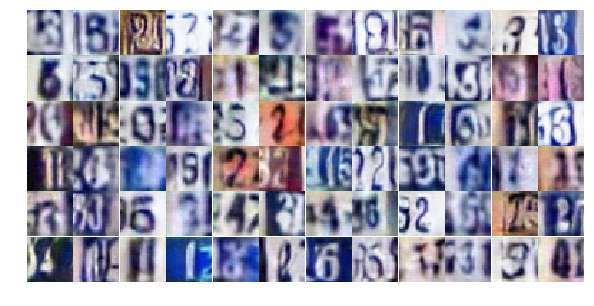

Epoch 13/25... Discriminator Loss: 0.5115... Generator Loss: 1.2982
Epoch 13/25... Discriminator Loss: 0.9966... Generator Loss: 1.3026
Epoch 13/25... Discriminator Loss: 0.8880... Generator Loss: 0.9821
Epoch 13/25... Discriminator Loss: 1.5894... Generator Loss: 0.4406
Epoch 13/25... Discriminator Loss: 1.2031... Generator Loss: 0.5373
Epoch 13/25... Discriminator Loss: 0.8652... Generator Loss: 1.4994
Epoch 13/25... Discriminator Loss: 0.4233... Generator Loss: 2.2727
Epoch 13/25... Discriminator Loss: 1.4194... Generator Loss: 0.3984
Epoch 13/25... Discriminator Loss: 0.4898... Generator Loss: 1.8807
Epoch 13/25... Discriminator Loss: 0.4208... Generator Loss: 1.7352


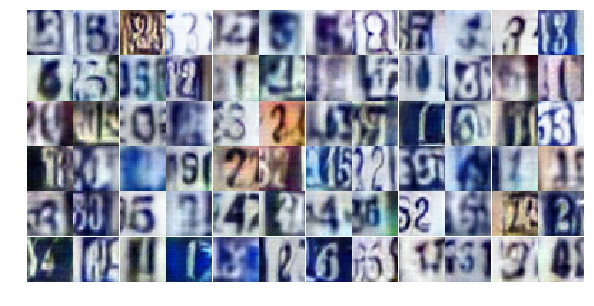

Epoch 13/25... Discriminator Loss: 0.9819... Generator Loss: 2.5393
Epoch 13/25... Discriminator Loss: 1.0763... Generator Loss: 0.6497
Epoch 13/25... Discriminator Loss: 2.0692... Generator Loss: 0.2326
Epoch 13/25... Discriminator Loss: 0.9477... Generator Loss: 1.3167
Epoch 13/25... Discriminator Loss: 0.6735... Generator Loss: 1.5274
Epoch 13/25... Discriminator Loss: 0.9660... Generator Loss: 0.9319
Epoch 13/25... Discriminator Loss: 0.7907... Generator Loss: 0.9209
Epoch 13/25... Discriminator Loss: 1.0001... Generator Loss: 0.6548
Epoch 13/25... Discriminator Loss: 0.9328... Generator Loss: 0.7437
Epoch 13/25... Discriminator Loss: 1.3403... Generator Loss: 0.6332


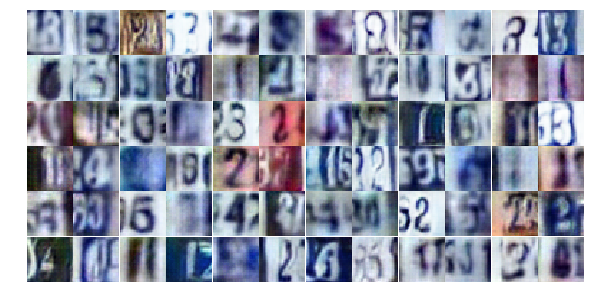

Epoch 13/25... Discriminator Loss: 0.4048... Generator Loss: 2.3679
Epoch 13/25... Discriminator Loss: 0.9305... Generator Loss: 0.8009
Epoch 13/25... Discriminator Loss: 0.5784... Generator Loss: 2.2774
Epoch 13/25... Discriminator Loss: 0.6872... Generator Loss: 1.4862
Epoch 13/25... Discriminator Loss: 1.2471... Generator Loss: 0.5325
Epoch 13/25... Discriminator Loss: 1.5436... Generator Loss: 0.4092
Epoch 13/25... Discriminator Loss: 1.1767... Generator Loss: 1.2586
Epoch 13/25... Discriminator Loss: 0.9271... Generator Loss: 0.7746
Epoch 13/25... Discriminator Loss: 1.1801... Generator Loss: 0.5550
Epoch 13/25... Discriminator Loss: 1.3345... Generator Loss: 0.4816


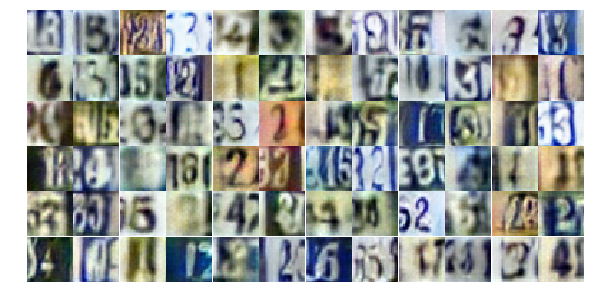

Epoch 13/25... Discriminator Loss: 0.7890... Generator Loss: 1.0122
Epoch 13/25... Discriminator Loss: 1.0981... Generator Loss: 0.6325
Epoch 13/25... Discriminator Loss: 1.7082... Generator Loss: 2.1574
Epoch 13/25... Discriminator Loss: 1.0738... Generator Loss: 0.9240
Epoch 13/25... Discriminator Loss: 0.9109... Generator Loss: 0.7083
Epoch 13/25... Discriminator Loss: 1.0894... Generator Loss: 0.6504
Epoch 13/25... Discriminator Loss: 0.8711... Generator Loss: 0.8615
Epoch 13/25... Discriminator Loss: 0.7368... Generator Loss: 1.6628
Epoch 13/25... Discriminator Loss: 0.6999... Generator Loss: 1.0039
Epoch 13/25... Discriminator Loss: 1.4774... Generator Loss: 0.3916


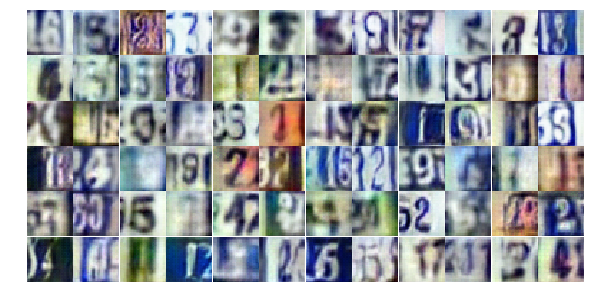

Epoch 13/25... Discriminator Loss: 1.1088... Generator Loss: 0.6141
Epoch 13/25... Discriminator Loss: 0.9476... Generator Loss: 0.7892
Epoch 13/25... Discriminator Loss: 0.5922... Generator Loss: 1.3544
Epoch 13/25... Discriminator Loss: 0.4303... Generator Loss: 2.0033
Epoch 13/25... Discriminator Loss: 0.7837... Generator Loss: 0.9751
Epoch 13/25... Discriminator Loss: 0.9228... Generator Loss: 0.7675
Epoch 13/25... Discriminator Loss: 0.9514... Generator Loss: 0.8544
Epoch 13/25... Discriminator Loss: 0.5590... Generator Loss: 1.2357
Epoch 13/25... Discriminator Loss: 1.1914... Generator Loss: 0.6571
Epoch 13/25... Discriminator Loss: 1.7473... Generator Loss: 0.3226


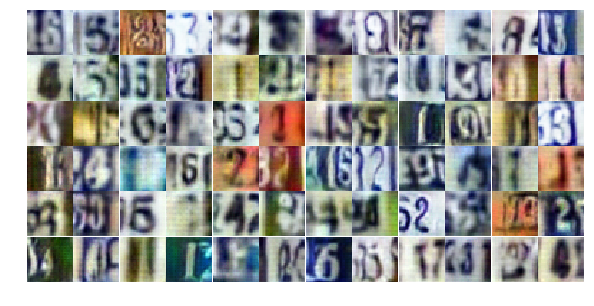

Epoch 13/25... Discriminator Loss: 0.5826... Generator Loss: 1.3563
Epoch 13/25... Discriminator Loss: 2.0141... Generator Loss: 0.2480
Epoch 13/25... Discriminator Loss: 0.7331... Generator Loss: 1.7776
Epoch 13/25... Discriminator Loss: 0.7345... Generator Loss: 0.9267
Epoch 14/25... Discriminator Loss: 0.5355... Generator Loss: 2.0156
Epoch 14/25... Discriminator Loss: 1.0698... Generator Loss: 1.9957
Epoch 14/25... Discriminator Loss: 0.8529... Generator Loss: 0.9032
Epoch 14/25... Discriminator Loss: 0.9499... Generator Loss: 1.5559
Epoch 14/25... Discriminator Loss: 0.5512... Generator Loss: 1.8329
Epoch 14/25... Discriminator Loss: 1.3726... Generator Loss: 0.4791


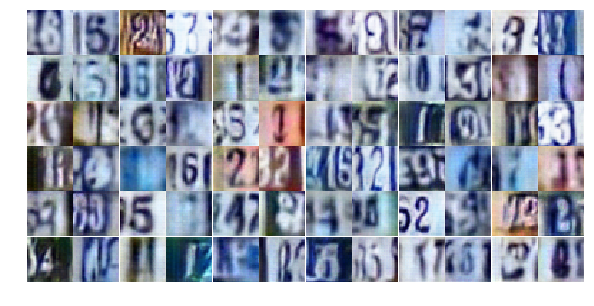

Epoch 14/25... Discriminator Loss: 0.9416... Generator Loss: 2.0699
Epoch 14/25... Discriminator Loss: 0.6760... Generator Loss: 1.0965
Epoch 14/25... Discriminator Loss: 0.6487... Generator Loss: 1.0551
Epoch 14/25... Discriminator Loss: 1.2349... Generator Loss: 0.4809
Epoch 14/25... Discriminator Loss: 0.8554... Generator Loss: 0.8548
Epoch 14/25... Discriminator Loss: 0.4884... Generator Loss: 1.4213
Epoch 14/25... Discriminator Loss: 0.9536... Generator Loss: 0.7762
Epoch 14/25... Discriminator Loss: 1.6654... Generator Loss: 0.4252
Epoch 14/25... Discriminator Loss: 1.4005... Generator Loss: 0.4615
Epoch 14/25... Discriminator Loss: 1.4679... Generator Loss: 0.4191


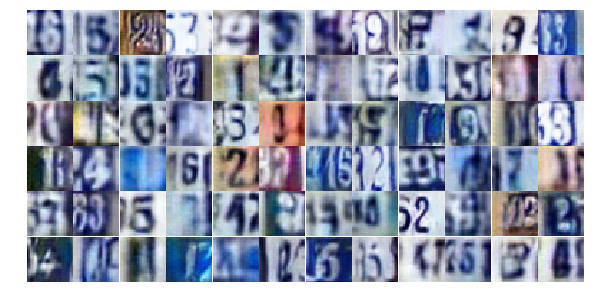

Epoch 14/25... Discriminator Loss: 1.0701... Generator Loss: 0.6109
Epoch 14/25... Discriminator Loss: 0.8632... Generator Loss: 1.7379
Epoch 14/25... Discriminator Loss: 0.9417... Generator Loss: 2.6905
Epoch 14/25... Discriminator Loss: 1.0606... Generator Loss: 2.3287
Epoch 14/25... Discriminator Loss: 1.6048... Generator Loss: 1.6364
Epoch 14/25... Discriminator Loss: 1.1087... Generator Loss: 0.6521
Epoch 14/25... Discriminator Loss: 0.8337... Generator Loss: 0.8770
Epoch 14/25... Discriminator Loss: 0.7370... Generator Loss: 1.1077
Epoch 14/25... Discriminator Loss: 0.5651... Generator Loss: 1.6812
Epoch 14/25... Discriminator Loss: 1.0999... Generator Loss: 0.9853


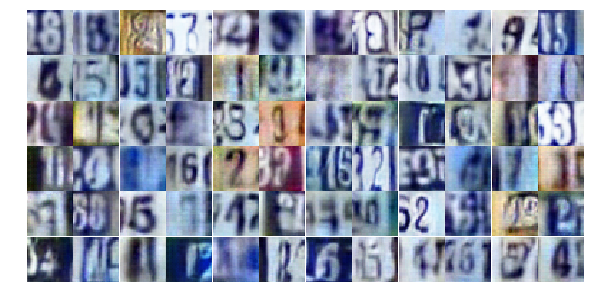

Epoch 14/25... Discriminator Loss: 0.8879... Generator Loss: 0.8430
Epoch 14/25... Discriminator Loss: 0.7700... Generator Loss: 0.9470
Epoch 14/25... Discriminator Loss: 0.4170... Generator Loss: 1.7294
Epoch 14/25... Discriminator Loss: 0.8203... Generator Loss: 1.5294
Epoch 14/25... Discriminator Loss: 1.3245... Generator Loss: 0.5005
Epoch 14/25... Discriminator Loss: 0.5407... Generator Loss: 1.4696
Epoch 14/25... Discriminator Loss: 1.0969... Generator Loss: 0.6637
Epoch 14/25... Discriminator Loss: 2.2850... Generator Loss: 3.3402
Epoch 14/25... Discriminator Loss: 0.7379... Generator Loss: 1.9955
Epoch 14/25... Discriminator Loss: 0.9411... Generator Loss: 0.7549


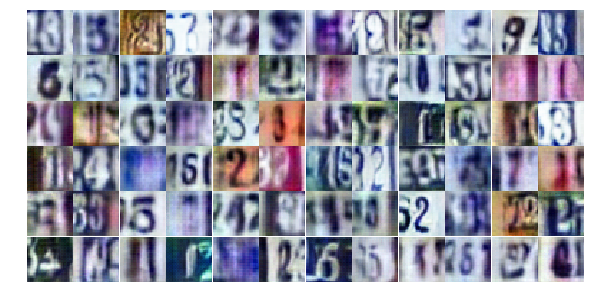

Epoch 14/25... Discriminator Loss: 0.8260... Generator Loss: 0.8619
Epoch 14/25... Discriminator Loss: 0.9353... Generator Loss: 0.8783
Epoch 14/25... Discriminator Loss: 1.2321... Generator Loss: 0.5302
Epoch 14/25... Discriminator Loss: 0.7498... Generator Loss: 1.0576
Epoch 14/25... Discriminator Loss: 1.1150... Generator Loss: 0.5382
Epoch 14/25... Discriminator Loss: 1.1482... Generator Loss: 1.0659
Epoch 14/25... Discriminator Loss: 0.5765... Generator Loss: 1.6766
Epoch 14/25... Discriminator Loss: 0.3308... Generator Loss: 2.1571
Epoch 14/25... Discriminator Loss: 1.3184... Generator Loss: 0.5449
Epoch 14/25... Discriminator Loss: 0.8418... Generator Loss: 1.8575


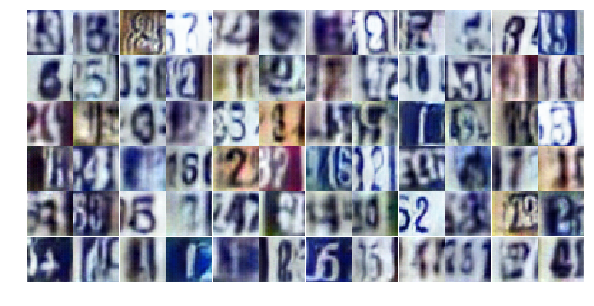

Epoch 14/25... Discriminator Loss: 1.2156... Generator Loss: 0.5307
Epoch 14/25... Discriminator Loss: 0.7121... Generator Loss: 1.0157
Epoch 14/25... Discriminator Loss: 0.7627... Generator Loss: 1.3139
Epoch 14/25... Discriminator Loss: 0.8500... Generator Loss: 0.8290
Epoch 14/25... Discriminator Loss: 0.5621... Generator Loss: 1.3661
Epoch 14/25... Discriminator Loss: 1.0293... Generator Loss: 0.9254
Epoch 14/25... Discriminator Loss: 0.9296... Generator Loss: 1.3987
Epoch 14/25... Discriminator Loss: 0.5917... Generator Loss: 1.0814
Epoch 14/25... Discriminator Loss: 0.6463... Generator Loss: 1.0518
Epoch 14/25... Discriminator Loss: 1.5405... Generator Loss: 0.3907


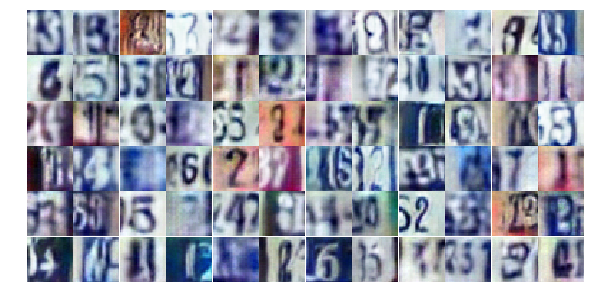

Epoch 14/25... Discriminator Loss: 0.9106... Generator Loss: 2.3995
Epoch 14/25... Discriminator Loss: 0.9063... Generator Loss: 0.8522
Epoch 15/25... Discriminator Loss: 0.4398... Generator Loss: 1.5249
Epoch 15/25... Discriminator Loss: 0.6231... Generator Loss: 1.3530
Epoch 15/25... Discriminator Loss: 0.2062... Generator Loss: 3.8144
Epoch 15/25... Discriminator Loss: 0.9405... Generator Loss: 0.8562
Epoch 15/25... Discriminator Loss: 0.9654... Generator Loss: 0.7006
Epoch 15/25... Discriminator Loss: 0.6813... Generator Loss: 1.4241
Epoch 15/25... Discriminator Loss: 1.4641... Generator Loss: 0.4063
Epoch 15/25... Discriminator Loss: 0.6638... Generator Loss: 1.3784


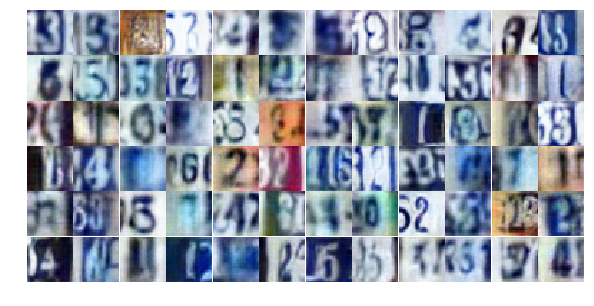

Epoch 15/25... Discriminator Loss: 1.2065... Generator Loss: 0.5489
Epoch 15/25... Discriminator Loss: 0.3661... Generator Loss: 1.6592
Epoch 15/25... Discriminator Loss: 2.8328... Generator Loss: 0.6136
Epoch 15/25... Discriminator Loss: 1.2784... Generator Loss: 0.5863
Epoch 15/25... Discriminator Loss: 1.6222... Generator Loss: 0.3624
Epoch 15/25... Discriminator Loss: 0.5465... Generator Loss: 1.4236
Epoch 15/25... Discriminator Loss: 1.7188... Generator Loss: 0.3397
Epoch 15/25... Discriminator Loss: 0.9568... Generator Loss: 1.0601
Epoch 15/25... Discriminator Loss: 0.3862... Generator Loss: 2.9385
Epoch 15/25... Discriminator Loss: 1.4136... Generator Loss: 0.4477


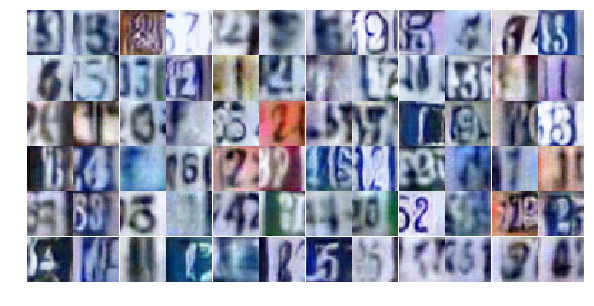

Epoch 15/25... Discriminator Loss: 0.6099... Generator Loss: 1.3542
Epoch 15/25... Discriminator Loss: 0.7838... Generator Loss: 1.0223
Epoch 15/25... Discriminator Loss: 0.6913... Generator Loss: 1.1749
Epoch 15/25... Discriminator Loss: 0.5459... Generator Loss: 1.2697
Epoch 15/25... Discriminator Loss: 0.7221... Generator Loss: 1.3209
Epoch 15/25... Discriminator Loss: 0.6998... Generator Loss: 1.2452
Epoch 15/25... Discriminator Loss: 0.3293... Generator Loss: 2.0712
Epoch 15/25... Discriminator Loss: 1.0210... Generator Loss: 0.6147
Epoch 15/25... Discriminator Loss: 0.9176... Generator Loss: 1.5730
Epoch 15/25... Discriminator Loss: 1.6406... Generator Loss: 0.3936


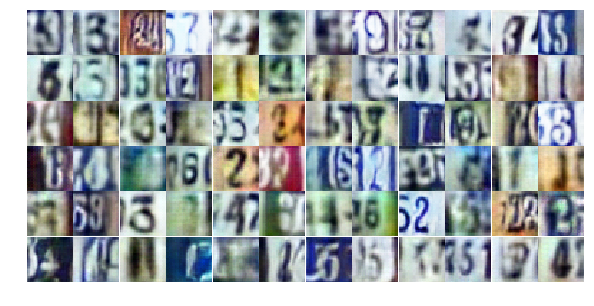

Epoch 15/25... Discriminator Loss: 0.8737... Generator Loss: 1.0672
Epoch 15/25... Discriminator Loss: 0.8861... Generator Loss: 1.5107
Epoch 15/25... Discriminator Loss: 0.5330... Generator Loss: 1.7521
Epoch 15/25... Discriminator Loss: 0.6382... Generator Loss: 1.0647
Epoch 15/25... Discriminator Loss: 0.5722... Generator Loss: 1.1928
Epoch 15/25... Discriminator Loss: 0.5930... Generator Loss: 1.9677
Epoch 15/25... Discriminator Loss: 1.4251... Generator Loss: 0.6012
Epoch 15/25... Discriminator Loss: 0.7322... Generator Loss: 1.0809
Epoch 15/25... Discriminator Loss: 0.8002... Generator Loss: 1.1555
Epoch 15/25... Discriminator Loss: 1.1077... Generator Loss: 0.6193


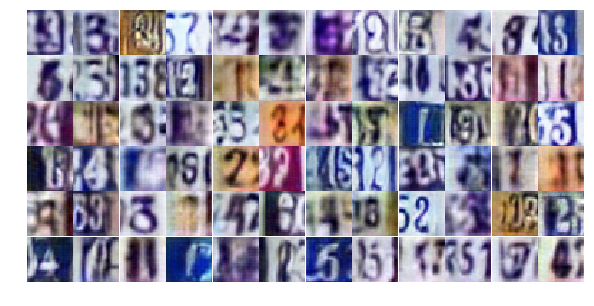

Epoch 15/25... Discriminator Loss: 0.5685... Generator Loss: 1.5422
Epoch 15/25... Discriminator Loss: 0.9798... Generator Loss: 0.8522
Epoch 15/25... Discriminator Loss: 0.8382... Generator Loss: 0.9941
Epoch 15/25... Discriminator Loss: 0.8058... Generator Loss: 1.9641
Epoch 15/25... Discriminator Loss: 1.1669... Generator Loss: 0.5702
Epoch 15/25... Discriminator Loss: 2.0886... Generator Loss: 0.2389
Epoch 15/25... Discriminator Loss: 0.9414... Generator Loss: 0.8547
Epoch 15/25... Discriminator Loss: 1.6322... Generator Loss: 0.4074
Epoch 15/25... Discriminator Loss: 0.9185... Generator Loss: 0.8436
Epoch 15/25... Discriminator Loss: 0.6416... Generator Loss: 1.1554


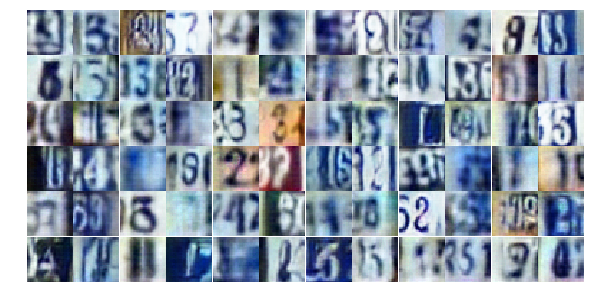

Epoch 15/25... Discriminator Loss: 1.5145... Generator Loss: 0.4030
Epoch 15/25... Discriminator Loss: 0.8399... Generator Loss: 1.1753
Epoch 15/25... Discriminator Loss: 1.4668... Generator Loss: 0.4370
Epoch 15/25... Discriminator Loss: 0.3046... Generator Loss: 2.3835
Epoch 15/25... Discriminator Loss: 1.1223... Generator Loss: 0.6181
Epoch 15/25... Discriminator Loss: 1.7974... Generator Loss: 0.3268
Epoch 15/25... Discriminator Loss: 1.7219... Generator Loss: 0.3731
Epoch 15/25... Discriminator Loss: 0.6876... Generator Loss: 1.5355
Epoch 15/25... Discriminator Loss: 1.5433... Generator Loss: 0.3559
Epoch 16/25... Discriminator Loss: 0.6370... Generator Loss: 1.2802


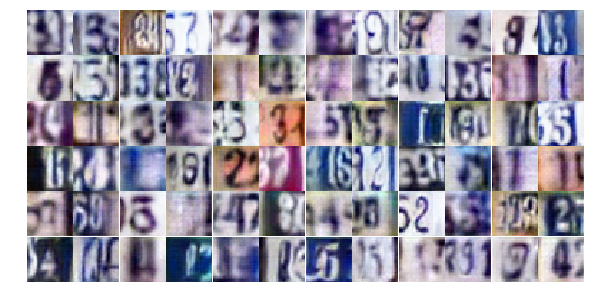

Epoch 16/25... Discriminator Loss: 1.3357... Generator Loss: 0.6388
Epoch 16/25... Discriminator Loss: 0.6845... Generator Loss: 1.0415
Epoch 16/25... Discriminator Loss: 1.2737... Generator Loss: 0.4723
Epoch 16/25... Discriminator Loss: 1.1343... Generator Loss: 0.6143
Epoch 16/25... Discriminator Loss: 1.4814... Generator Loss: 0.3773
Epoch 16/25... Discriminator Loss: 1.3348... Generator Loss: 0.5281
Epoch 16/25... Discriminator Loss: 1.9085... Generator Loss: 0.3245
Epoch 16/25... Discriminator Loss: 0.7657... Generator Loss: 1.4977
Epoch 16/25... Discriminator Loss: 0.2672... Generator Loss: 2.2360
Epoch 16/25... Discriminator Loss: 0.8129... Generator Loss: 1.0575


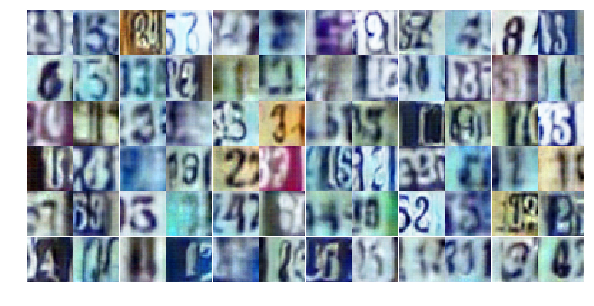

Epoch 16/25... Discriminator Loss: 1.2553... Generator Loss: 0.5584
Epoch 16/25... Discriminator Loss: 0.7534... Generator Loss: 1.2063
Epoch 16/25... Discriminator Loss: 0.6478... Generator Loss: 1.0405
Epoch 16/25... Discriminator Loss: 1.3365... Generator Loss: 0.5590
Epoch 16/25... Discriminator Loss: 0.5699... Generator Loss: 1.2899
Epoch 16/25... Discriminator Loss: 1.2431... Generator Loss: 0.5253
Epoch 16/25... Discriminator Loss: 1.8398... Generator Loss: 0.2739
Epoch 16/25... Discriminator Loss: 0.4968... Generator Loss: 1.4997
Epoch 16/25... Discriminator Loss: 0.3786... Generator Loss: 2.0514
Epoch 16/25... Discriminator Loss: 0.7110... Generator Loss: 2.0608


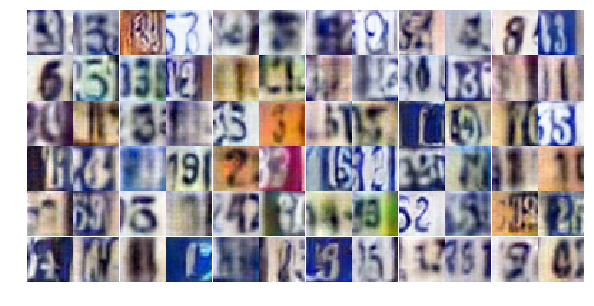

Epoch 16/25... Discriminator Loss: 0.5561... Generator Loss: 1.6917
Epoch 16/25... Discriminator Loss: 0.9859... Generator Loss: 0.9360
Epoch 16/25... Discriminator Loss: 0.5077... Generator Loss: 1.5640
Epoch 16/25... Discriminator Loss: 0.7507... Generator Loss: 1.0985
Epoch 16/25... Discriminator Loss: 0.5330... Generator Loss: 1.4467
Epoch 16/25... Discriminator Loss: 0.8952... Generator Loss: 1.2132
Epoch 16/25... Discriminator Loss: 1.7049... Generator Loss: 0.4400
Epoch 16/25... Discriminator Loss: 0.9398... Generator Loss: 0.7790
Epoch 16/25... Discriminator Loss: 2.1080... Generator Loss: 0.2073
Epoch 16/25... Discriminator Loss: 0.7265... Generator Loss: 1.3082


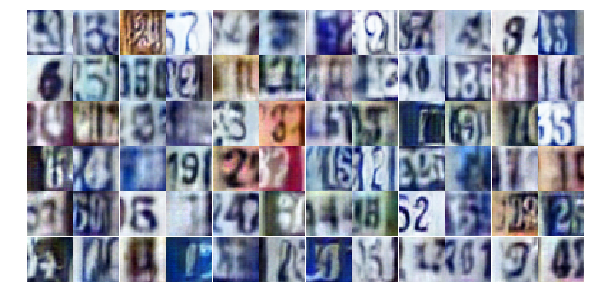

Epoch 16/25... Discriminator Loss: 1.3753... Generator Loss: 0.4218
Epoch 16/25... Discriminator Loss: 0.8699... Generator Loss: 0.8328
Epoch 16/25... Discriminator Loss: 0.8827... Generator Loss: 2.5243
Epoch 16/25... Discriminator Loss: 0.8059... Generator Loss: 1.0829
Epoch 16/25... Discriminator Loss: 1.2512... Generator Loss: 0.5258
Epoch 16/25... Discriminator Loss: 0.8653... Generator Loss: 1.9056
Epoch 16/25... Discriminator Loss: 0.8056... Generator Loss: 0.9180
Epoch 16/25... Discriminator Loss: 2.0932... Generator Loss: 0.2246
Epoch 16/25... Discriminator Loss: 0.9767... Generator Loss: 0.8643
Epoch 16/25... Discriminator Loss: 0.5873... Generator Loss: 1.8506


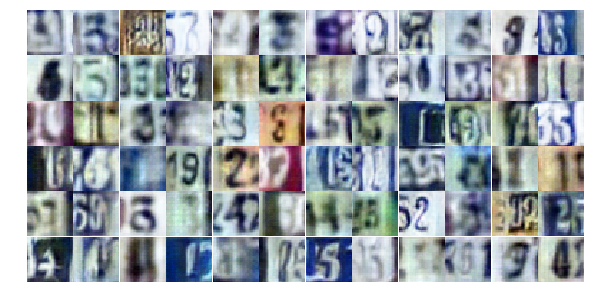

Epoch 16/25... Discriminator Loss: 0.5253... Generator Loss: 1.4480
Epoch 16/25... Discriminator Loss: 0.6244... Generator Loss: 3.5203
Epoch 16/25... Discriminator Loss: 1.3734... Generator Loss: 0.5618
Epoch 16/25... Discriminator Loss: 1.1617... Generator Loss: 0.7242
Epoch 16/25... Discriminator Loss: 1.0367... Generator Loss: 0.6644
Epoch 16/25... Discriminator Loss: 0.7331... Generator Loss: 1.1105
Epoch 16/25... Discriminator Loss: 1.3454... Generator Loss: 0.8980
Epoch 16/25... Discriminator Loss: 0.6611... Generator Loss: 1.3313
Epoch 16/25... Discriminator Loss: 0.9628... Generator Loss: 0.8169
Epoch 16/25... Discriminator Loss: 0.6368... Generator Loss: 1.3384


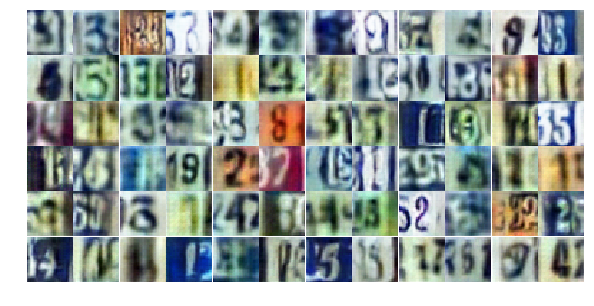

Epoch 16/25... Discriminator Loss: 1.4089... Generator Loss: 0.6460
Epoch 16/25... Discriminator Loss: 1.0899... Generator Loss: 1.9104
Epoch 16/25... Discriminator Loss: 1.8997... Generator Loss: 0.3287
Epoch 16/25... Discriminator Loss: 0.8721... Generator Loss: 1.0137
Epoch 16/25... Discriminator Loss: 0.6222... Generator Loss: 1.3582
Epoch 16/25... Discriminator Loss: 0.8332... Generator Loss: 0.8897
Epoch 17/25... Discriminator Loss: 1.2389... Generator Loss: 0.6282
Epoch 17/25... Discriminator Loss: 0.8483... Generator Loss: 0.9078
Epoch 17/25... Discriminator Loss: 0.9335... Generator Loss: 0.8235
Epoch 17/25... Discriminator Loss: 0.8069... Generator Loss: 0.9671


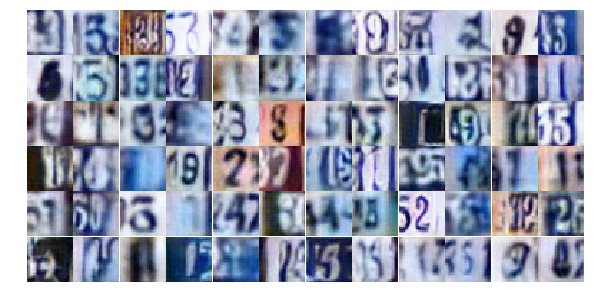

Epoch 17/25... Discriminator Loss: 0.7687... Generator Loss: 1.1040
Epoch 17/25... Discriminator Loss: 0.3458... Generator Loss: 2.0713
Epoch 17/25... Discriminator Loss: 1.2236... Generator Loss: 0.6024
Epoch 17/25... Discriminator Loss: 1.0936... Generator Loss: 0.8919
Epoch 17/25... Discriminator Loss: 0.7901... Generator Loss: 0.8613
Epoch 17/25... Discriminator Loss: 1.0193... Generator Loss: 0.7744
Epoch 17/25... Discriminator Loss: 0.6984... Generator Loss: 1.7594
Epoch 17/25... Discriminator Loss: 0.5238... Generator Loss: 1.3282
Epoch 17/25... Discriminator Loss: 0.7143... Generator Loss: 0.9802
Epoch 17/25... Discriminator Loss: 0.6181... Generator Loss: 1.0332


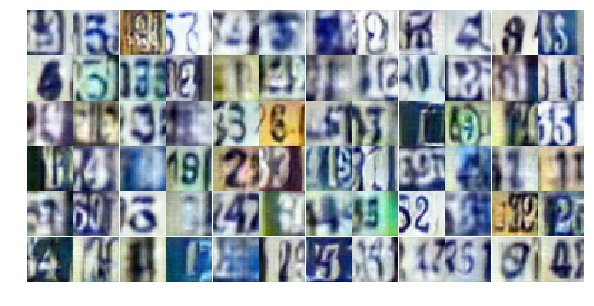

Epoch 17/25... Discriminator Loss: 1.2258... Generator Loss: 1.0824
Epoch 17/25... Discriminator Loss: 0.9026... Generator Loss: 2.3923
Epoch 17/25... Discriminator Loss: 0.8847... Generator Loss: 0.9089
Epoch 17/25... Discriminator Loss: 1.0632... Generator Loss: 0.6731
Epoch 17/25... Discriminator Loss: 0.7137... Generator Loss: 2.4890
Epoch 17/25... Discriminator Loss: 0.6577... Generator Loss: 1.2066
Epoch 17/25... Discriminator Loss: 0.3659... Generator Loss: 1.8554
Epoch 17/25... Discriminator Loss: 0.6653... Generator Loss: 1.9813
Epoch 17/25... Discriminator Loss: 0.9355... Generator Loss: 0.7221
Epoch 17/25... Discriminator Loss: 0.4230... Generator Loss: 1.6573


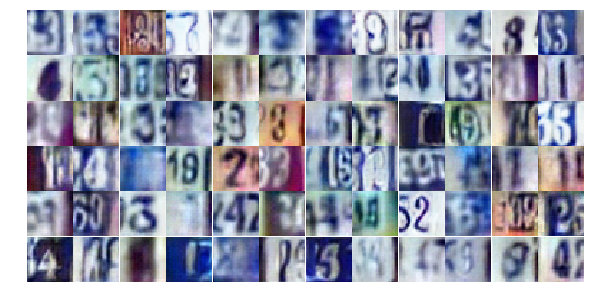

Epoch 17/25... Discriminator Loss: 1.5033... Generator Loss: 2.5776
Epoch 17/25... Discriminator Loss: 0.8933... Generator Loss: 2.6169
Epoch 17/25... Discriminator Loss: 0.8725... Generator Loss: 1.7619
Epoch 17/25... Discriminator Loss: 1.8122... Generator Loss: 0.2951
Epoch 17/25... Discriminator Loss: 1.3224... Generator Loss: 0.5844
Epoch 17/25... Discriminator Loss: 1.0992... Generator Loss: 0.6354
Epoch 17/25... Discriminator Loss: 0.7975... Generator Loss: 0.9649
Epoch 17/25... Discriminator Loss: 1.3198... Generator Loss: 0.5072
Epoch 17/25... Discriminator Loss: 1.0020... Generator Loss: 0.9154
Epoch 17/25... Discriminator Loss: 0.8492... Generator Loss: 0.9564


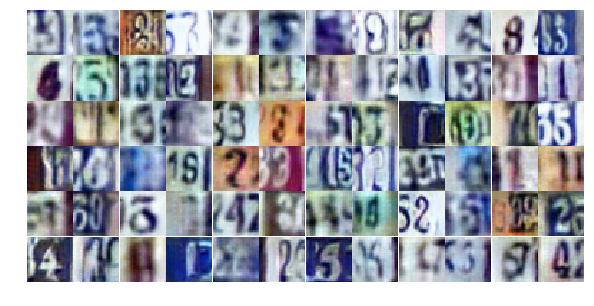

Epoch 17/25... Discriminator Loss: 0.8728... Generator Loss: 0.9317
Epoch 17/25... Discriminator Loss: 1.9515... Generator Loss: 0.3134
Epoch 17/25... Discriminator Loss: 0.9532... Generator Loss: 1.6713
Epoch 17/25... Discriminator Loss: 1.1129... Generator Loss: 0.7865
Epoch 17/25... Discriminator Loss: 0.8153... Generator Loss: 1.7703
Epoch 17/25... Discriminator Loss: 0.7020... Generator Loss: 1.0829
Epoch 17/25... Discriminator Loss: 1.6584... Generator Loss: 0.4135
Epoch 17/25... Discriminator Loss: 0.6842... Generator Loss: 1.4037
Epoch 17/25... Discriminator Loss: 0.2331... Generator Loss: 2.2772
Epoch 17/25... Discriminator Loss: 0.7054... Generator Loss: 1.0160


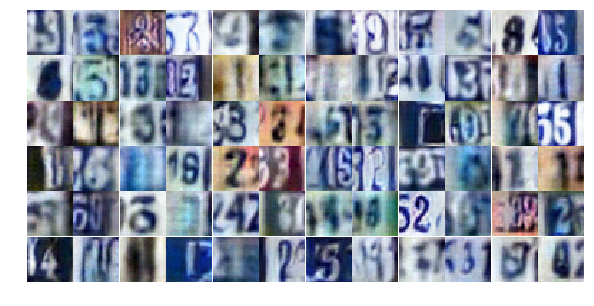

Epoch 17/25... Discriminator Loss: 2.6539... Generator Loss: 2.5670
Epoch 17/25... Discriminator Loss: 1.8086... Generator Loss: 3.3209
Epoch 17/25... Discriminator Loss: 1.2618... Generator Loss: 0.9004
Epoch 17/25... Discriminator Loss: 0.6201... Generator Loss: 1.5044
Epoch 17/25... Discriminator Loss: 0.9755... Generator Loss: 0.9944
Epoch 17/25... Discriminator Loss: 1.8083... Generator Loss: 0.2876
Epoch 17/25... Discriminator Loss: 1.5179... Generator Loss: 0.4372
Epoch 17/25... Discriminator Loss: 0.7074... Generator Loss: 1.1244
Epoch 17/25... Discriminator Loss: 1.8633... Generator Loss: 4.0049
Epoch 17/25... Discriminator Loss: 1.5402... Generator Loss: 0.4666


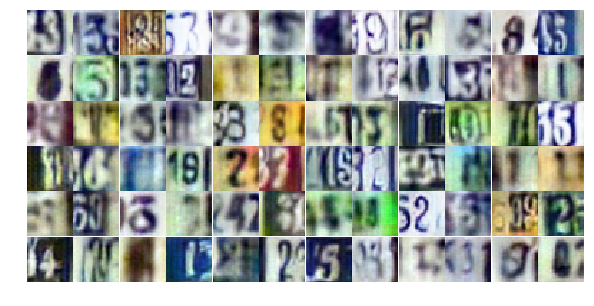

Epoch 17/25... Discriminator Loss: 0.7536... Generator Loss: 1.3188
Epoch 17/25... Discriminator Loss: 1.0721... Generator Loss: 0.5991
Epoch 17/25... Discriminator Loss: 0.5463... Generator Loss: 1.5754
Epoch 17/25... Discriminator Loss: 1.1326... Generator Loss: 0.6243
Epoch 18/25... Discriminator Loss: 1.9126... Generator Loss: 0.2992
Epoch 18/25... Discriminator Loss: 1.8074... Generator Loss: 0.3303
Epoch 18/25... Discriminator Loss: 1.1308... Generator Loss: 0.6947
Epoch 18/25... Discriminator Loss: 0.9814... Generator Loss: 0.6715
Epoch 18/25... Discriminator Loss: 1.1630... Generator Loss: 0.5585
Epoch 18/25... Discriminator Loss: 0.3423... Generator Loss: 1.6215


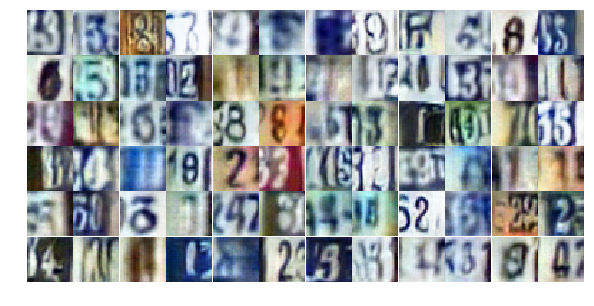

Epoch 18/25... Discriminator Loss: 1.0919... Generator Loss: 0.6300
Epoch 18/25... Discriminator Loss: 0.8434... Generator Loss: 1.1955
Epoch 18/25... Discriminator Loss: 1.0769... Generator Loss: 0.6792
Epoch 18/25... Discriminator Loss: 0.4580... Generator Loss: 1.7520
Epoch 18/25... Discriminator Loss: 0.5863... Generator Loss: 1.6393
Epoch 18/25... Discriminator Loss: 0.4229... Generator Loss: 1.6572
Epoch 18/25... Discriminator Loss: 0.6296... Generator Loss: 1.1855
Epoch 18/25... Discriminator Loss: 1.0396... Generator Loss: 0.7606
Epoch 18/25... Discriminator Loss: 0.7030... Generator Loss: 1.9229
Epoch 18/25... Discriminator Loss: 0.6340... Generator Loss: 1.2270


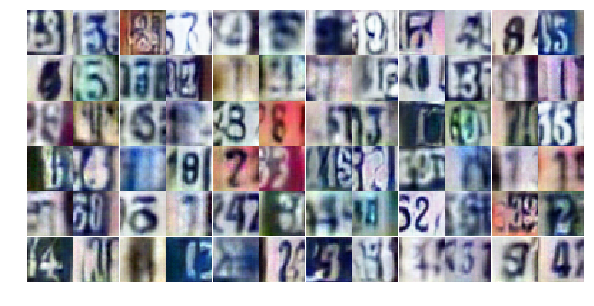

Epoch 18/25... Discriminator Loss: 0.5948... Generator Loss: 1.7747
Epoch 18/25... Discriminator Loss: 0.8712... Generator Loss: 1.0205
Epoch 18/25... Discriminator Loss: 1.3684... Generator Loss: 0.5204
Epoch 18/25... Discriminator Loss: 0.5865... Generator Loss: 1.2604
Epoch 18/25... Discriminator Loss: 1.8393... Generator Loss: 0.4215
Epoch 18/25... Discriminator Loss: 1.4831... Generator Loss: 0.4234
Epoch 18/25... Discriminator Loss: 1.3333... Generator Loss: 0.5524
Epoch 18/25... Discriminator Loss: 0.5608... Generator Loss: 1.3124
Epoch 18/25... Discriminator Loss: 0.7355... Generator Loss: 1.7962
Epoch 18/25... Discriminator Loss: 1.2342... Generator Loss: 0.5473


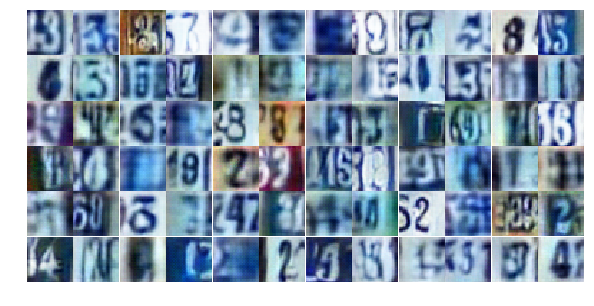

Epoch 18/25... Discriminator Loss: 0.6788... Generator Loss: 1.4244
Epoch 18/25... Discriminator Loss: 1.0170... Generator Loss: 0.9760
Epoch 18/25... Discriminator Loss: 1.6247... Generator Loss: 0.4247
Epoch 18/25... Discriminator Loss: 1.0044... Generator Loss: 0.7539
Epoch 18/25... Discriminator Loss: 2.4844... Generator Loss: 0.1358
Epoch 18/25... Discriminator Loss: 0.4690... Generator Loss: 1.5569
Epoch 18/25... Discriminator Loss: 1.0053... Generator Loss: 0.7873
Epoch 18/25... Discriminator Loss: 0.6119... Generator Loss: 1.2985
Epoch 18/25... Discriminator Loss: 1.2775... Generator Loss: 0.5223
Epoch 18/25... Discriminator Loss: 0.4114... Generator Loss: 2.2412


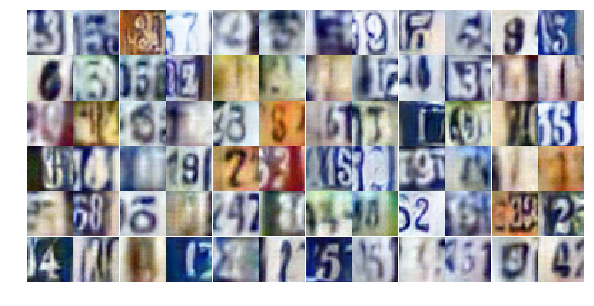

Epoch 18/25... Discriminator Loss: 0.6117... Generator Loss: 1.2429
Epoch 18/25... Discriminator Loss: 0.4125... Generator Loss: 1.6231
Epoch 18/25... Discriminator Loss: 0.5983... Generator Loss: 1.7238
Epoch 18/25... Discriminator Loss: 1.6994... Generator Loss: 0.3325
Epoch 18/25... Discriminator Loss: 0.4467... Generator Loss: 1.5641
Epoch 18/25... Discriminator Loss: 0.3044... Generator Loss: 1.7137
Epoch 18/25... Discriminator Loss: 1.1197... Generator Loss: 0.6404
Epoch 18/25... Discriminator Loss: 0.7747... Generator Loss: 2.2968


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

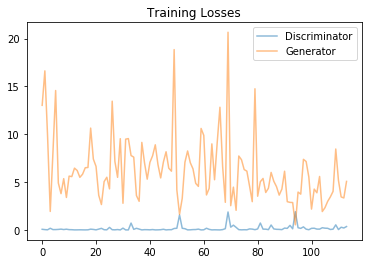

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

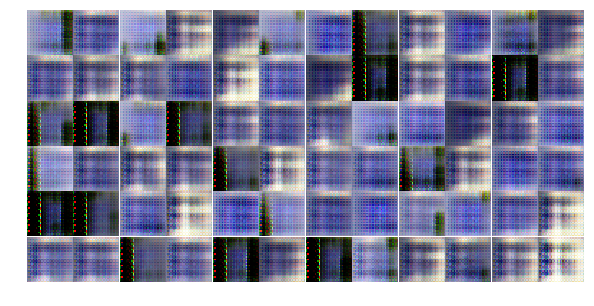

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))